In [66]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import warnings
import pickle

warnings.filterwarnings("ignore")

In [4]:
#!pip install zstandard
# import zstandard as zstd

In [67]:
# csv too large, save to .pkl for easier access and less space

#df = pd.read_csv('EUR_JPY.csv', index_col=0)
#df.Time = pd.to_datetime(df.Time)
#df.columns = ['Time','BID_PRICE', 'BID_SIZE', 'ASK_PRICE','ASK_SIZE']

#df.to_pickle('EUR_JPY.pkl')
df = pd.read_pickle('EUR_JPY.pkl')

# number of seconds between two adjecent rows
num_seconds = (df.Time.iloc[1] - df.Time.iloc[0]).total_seconds()
num_seconds

0.1

In [68]:
def moving_average_signal(df, short_window, long_window, b,delay):
    """
    Generate trading signals based on moving average cross-over strategy.

    Params:
    prices (Series): asset prices
    short_window (int): Window size for the short-term moving average
    long_window (int): Window size for the long-term moving average
    b (int): Bandwidth parameter that determines the buy/sell thresholds

    Return:
    return (Series): Series with trading signals (+1 for buy, -1 for sell, 0 for hold)
    """

    # Create midprice column (average of bid and ask prices)
    mid_price = (df['BID_PRICE'] + df['ASK_PRICE']) / 2
    
    # Calculate short-term and long-term moving averages
    short_ma = mid_price.rolling(window=short_window).mean()
    long_ma = mid_price.rolling(window=long_window).mean()
    
    # Define thresholds
    upper_threshold = (1 + b) * long_ma
    lower_threshold = (1 - b) * long_ma
    
    signal = pd.Series(0, index=df.index)

    # Generate buy signals (+1 where short_ma > upper_threshold)
    signal[short_ma > upper_threshold] = 1
    
    # Generate sell signals (-1 where short_ma < lower_threshold)
    signal[short_ma < lower_threshold] = -1

    # Delay signal by 'delay' periods to account for trading frictions
    signal = signal.shift(delay).fillna(0)

    # Last trading time for each day is 15:50, set the signal at this time = 0 to make sure no overnight position
    signal[df.Time.dt.time == pd.to_datetime('15:50').time()] = 0

    return signal

def momentum_in_price_signal(df, short_window, long_window, b,delay):
    """
    Generate trading signals based on momentum in price strategy.

    Params:
    prices (Series): asset prices
    short_window (int): Window size for the short-term moving average
    long_window (int): Window size for the long-term moving average
    b (int): Bandwidth parameter that determines the buy/sell thresholds

    Return:
    return (Series): Series with trading signals (+1 for buy, -1 for sell, 0 for hold)
    """

    # Create midprice column (average of bid and ask prices)
    mid_price = (df['BID_PRICE'] + df['ASK_PRICE']) / 2
    returns = mid_price.pct_change()

    # Calculate short-term and long-term moving averages
    short_ma = returns.rolling(window=short_window).mean()
    long_ma = returns.rolling(window=long_window).mean()
    
    # Define thresholds
    upper_threshold = (1 + b) * long_ma
    lower_threshold = (1 - b) * long_ma
    
    signal = pd.Series(0, index=df.index)

    # Generate buy signals (+1 where short_ma > upper_threshold)
    signal[short_ma > upper_threshold] = 1
    
    # Generate sell signals (-1 where short_ma < lower_threshold)
    signal[short_ma < lower_threshold] = -1

    # Delay signal by 'delay' periods to account for trading frictions
    signal = signal.shift(delay).fillna(0)

    # Last trading time for each day is 15:50, set the signal at this time = 0 to make sure no overnight position
    signal[df.Time.dt.time == pd.to_datetime('15:50').time()] = 0

    return signal

def spread_order_imbalance(df, short_window,long_window, delay):
    """
    Generate trading signals based on spread order imbalance strategy.

    Params:
    df (DataFrame): DataFrame containing bid and ask prices and volumes
    delay (int): Number of periods to delay the signal

    Return:
    return (Series): Series with trading signals (+1 for buy, -1 for sell, 0 for hold)
    """

    # Calculate spread
    spread = df['ASK_PRICE'] - df['BID_PRICE']

    # Calculate short-term and long-term moving averages of spread
    spread_ma_short= spread.rolling(window=short_window).mean()
    spread_ma_long = spread.rolling(window=long_window).mean()

    
    # Calculate order imbalance
    order_imbalance = (df['ASK_SIZE'] - df['BID_SIZE']) / (df['ASK_SIZE'] + df['BID_SIZE'])
    
    # Generate signal based on order imbalance and spread
    signal = pd.Series(0, index=df.index)
    signal[(spread_ma_short<spread_ma_long)&(order_imbalance > 0.5)] = 1
    signal[(spread_ma_short>spread_ma_long)&(order_imbalance < -0.5)] = -1

    # Delay signal by 'delay' periods to account for trading frictions
    signal = signal.shift(delay).fillna(0)

    # Last trading time for each day is 15:50, set the signal at this time = 0 to make sure no overnight position
    signal[df.Time.dt.time == pd.to_datetime('15:50').time()] = 0

    return signal


In [117]:
def execute_trading_signal(df, signal, order_size=1_000_000):
    """
    Execute the trading signal based on the available order book depth and calculate actual P&L.
    
    Params:
    bbo_df (DataFrame): DataFrame containing the order book and signals for each day.
    signal (Series): Series containing the generated trading signals.
    order_size (float): Size of the order for each trade (default $1M).
    
    Returns:
    DataFrame: Updated DataFrame with calculated returns.
    """

    # Initialize position and return
    position = 0
    shares_held = 0
    bbo_df = df.copy()
    bbo_df['return'] = 0
    bbo_df['cum_return'] = 0
    cum_return = []
    current_sign = np.sign(signal.iloc[0])

    # Process MPB-10 data to get 3-level deep order book
    #bids, asks = process_mpb10_data(bbo_df)
    bids = bbo_df[['BID_PRICE','BID_SIZE']].copy()
    asks = bbo_df[['ASK_PRICE', 'ASK_SIZE']].copy()

    # Track the first signal to open a position, then exit when the signal reverses
    open_position = False
    
    for i in signal.index:
        current_signal = signal.loc[i]
        
        # Buy logic: first time signal turns +1 and we don't have an open position
        if current_signal == 1 and (not open_position or shares_held == 0) and order_size > 0:
            shares_bought = 0
            position = 0

            ### Buy up to 3 levels of the ask side until $1M is spent
            ask_price = asks.ASK_PRICE.iloc[i]
            ask_size = asks.ASK_SIZE.iloc[i]
            available = min(order_size, ask_price * ask_size)

            # Calculate number of shares to buy
            shares_bought += available / ask_price
            order_size -= ask_price * shares_bought


            position += ask_price * shares_bought
            shares_held += shares_bought
            open_position = True  # Mark that position is open
            
            
            # Mark the negative cash flow from buying
            bbo_df['return'].iloc[i] = -position
            
        # Sell logic: first time signal turns -1 and we don't have an open position
        elif current_signal == -1 and (not open_position or shares_held == 0):
            shares_sold = 0
            #revenue = 0

            ### Sell up to 3 levels of the bid side, until $1M worth of shares are sold
            bid_price = bids.BID_PRICE.iloc[i]
            bid_size = bids.BID_SIZE.iloc[i]
            #level_revenue = min(order_size + bid_price*shares_held - revenue, bid_price * bid_size)
            available = min(order_size, bid_price * bid_size)
            #level_shares = level_revenue / bid_price

            shares_sold += available / bid_price
            order_size += shares_sold * bid_price
            #revenue += level_revenue

            #if revenue >= order_size:
                #break
            
            position -= shares_sold * bid_price
            shares_held -= shares_sold
            open_position = True

            # Mark the positive cash flow from selling
            bbo_df['return'].iloc[i] = position

        
        # Exit logic: signal turns 0 and we have an open position
        elif np.sign(current_signal) != current_sign and open_position:
            # Liquidate the position by settling the open trade
            if shares_held > 0:
                # Sell all shares at the bid price
                bid_price = bids.BID_PRICE.iloc[i]
                bid_size = bids.BID_SIZE.iloc[i]
                sell_qty = min(shares_held, bid_size)
                position -= sell_qty * bid_price
                shares_held -= sell_qty

                if(shares_held == 0):
                    open_position = False
                      
                order_size += sell_qty * bid_price
                # Mark the positive cash flow from selling
                bbo_df['return'].iloc[i] = sell_qty * bid_price

            elif shares_held < 0:
                # Buy back all shares at the ask price
                ask_price = asks.ASK_PRICE.iloc[i]
                ask_size = asks.ASK_SIZE.iloc[i]
                buy_qty = min(-shares_held, ask_size)
                position += buy_qty * ask_price
                shares_held += buy_qty
                if(shares_held == 0):
                    open_position = False
                
                order_size -= buy_qty * ask_price
                # Mark the negative cash flow from buying
                bbo_df['return'].iloc[i] = -buy_qty * ask_price
        
        # Track the return through order_size remain
        current_sign = np.sign(current_signal)
        cum_return.append(order_size)
    bbo_df['cum_return'] = cum_return
    #bbo_df['scaled_return'] = bbo_df['cumulative_return'] / 1_000_000
    
    return bbo_df


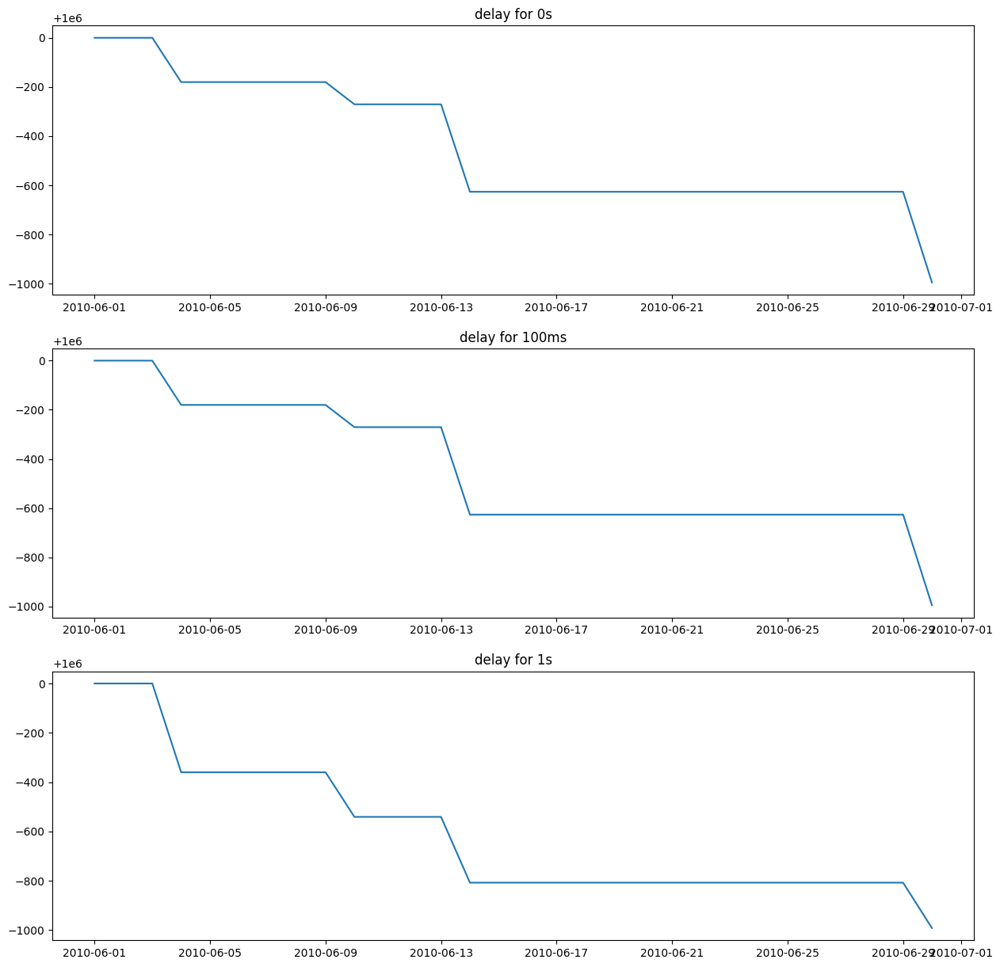

In [104]:
# test plot for MA

delay = [0, 1, 10]
name = ['0s','100ms','1s']
fig, ax = plt.subplots(3,1, figsize=(15,15))

for i, j in enumerate(delay):
    signal1 = moving_average_signal(df, 12, 26, 0.005, j)
    ret = execute_trading_signal(df, signal1, order_size=1_000_000)
    ax[i].plot(ret.set_index('Time').resample('D').last().cum_return)
    ax[i].set_title(f'delay for {name[i]}')

plt.show()

In [ ]:
# test plot for OBV

delay = [0, 1, 10]
name = ['0s','100ms','1s']
fig, ax = plt.subplots(3,1, figsize=(15,15))

for i, j in enumerate(delay):
    signal1 = spread_order_imbalance(df, 12, 26, 1)
    ret = execute_trading_signal(df, signal1, order_size=1_000_000)
    ax[i].plot(ret.set_index('Time').resample('D').last().cum_return)
    ax[i].set_title(f'delay for {name[i]}')

plt.show()

size 9006.57479960371
ss return 666009 -999999.9999999999
money left 2000000.0
size left 0.0
buyback return 666017 -1000180.131495992
money left 999819.868504008
size 9047.324843941797
buy return 1831067 -999819.868504008
money left 0.0
size left 0.0
close return 1831073 999729.3952555686
money left 999729.3952555686
size 8892.80728745391
buy return 2551645 -999729.3952555686
money left 0.0
size left 0.0
close return 2551646 999373.6829640704
money left 999373.6829640704
size 9211.666356015028
ss return 5760803 -999017.9706725721
money left 1998747.3659281407
size left 0.0
buyback return 5760808 -999742.149618311
money left 999005.2163098297
size 8978.27258035554
ss return 27 -1000000
money left 2000000.0
size 17951.709900368012
buy return 39 -2000000.0000000002
money left -2.3283064365386963e-10
size left 0.0
close return 53 999371.714329789
money left 999371.7143297888
size 8973.43732001247
ss return 54 1256.5713404223789
money left 1998743.4286595776
size 17942.04154990644
buy retur

size -9.005714938571408e+233
ss return 2326 2.0052124882223097e+236
money left -2.0052124882223097e+236
size -1.8011429877142816e+234
ss return 2327 4.0104249764446195e+236
money left -4.0104249764446195e+236
size -3.602285975428563e+234
ss return 2328 8.020849952889239e+236
money left -8.020849952889239e+236
size -7.204571950857126e+234
ss return 2329 1.6041699905778478e+237
money left -1.6041699905778478e+237
size -1.441043829121315e+235
ss return 2338 3.2083399811556956e+237
money left -3.2083399811556956e+237
size -2.88208765824263e+235
ss return 2339 6.416679962311391e+237
money left -6.416679962311391e+237
size -5.76417531648526e+235
ss return 2340 1.2833359924622782e+238
money left -1.2833359924622782e+238
size -1.152835063297052e+236
ss return 2341 2.5666719849245565e+238
money left -2.5666719849245565e+238
size -2.305670126594104e+236
ss return 2342 5.133343969849113e+238
money left -5.133343969849113e+238
size -4.611340253188208e+236
ss return 2343 1.0266687939698226e+239
mon

size -inf
ss return 5378 inf
money left -inf
size -inf
ss return 5379 inf
money left -inf
size -inf
ss return 5380 inf
money left -inf
size -inf
ss return 5381 inf
money left -inf
size -inf
ss return 5382 inf
money left -inf
size -inf
ss return 5383 inf
money left -inf
size -inf
ss return 5384 inf
money left -inf
size -inf
ss return 5385 inf
money left -inf
size -inf
ss return 5386 inf
money left -inf
size -inf
ss return 5387 inf
money left -inf
size -inf
ss return 5388 inf
money left -inf
size -inf
ss return 5402 inf
money left -inf
size -inf
ss return 5406 inf
money left -inf
size -inf
ss return 5407 inf
money left -inf
size -inf
ss return 5408 inf
money left -inf
size -inf
ss return 5409 inf
money left -inf
size -inf
ss return 5410 inf
money left -inf
size -inf
ss return 5411 inf
money left -inf
size -inf
ss return 5412 inf
money left -inf
size -inf
ss return 5413 inf
money left -inf
size -inf
ss return 5414 inf
money left -inf
size -inf
ss return 5415 inf
money left -inf
size -inf


size -inf
ss return 8902 inf
money left -inf
size -inf
ss return 8903 inf
money left -inf
size -inf
ss return 8904 inf
money left -inf
size -inf
ss return 8905 inf
money left -inf
size -inf
ss return 8906 inf
money left -inf
size -inf
ss return 8907 inf
money left -inf
size -inf
ss return 8908 inf
money left -inf
size -inf
ss return 8909 inf
money left -inf
size -inf
ss return 8910 inf
money left -inf
size -inf
ss return 8911 inf
money left -inf
size -inf
ss return 8912 inf
money left -inf
size -inf
ss return 8913 inf
money left -inf
size -inf
ss return 8914 inf
money left -inf
size -inf
ss return 8915 inf
money left -inf
size -inf
ss return 8916 inf
money left -inf
size left inf
close return 8917 222620000.0
money left -inf
size left inf
close return 8918 222620000.0
money left -inf
size left inf
close return 8919 222620000.0
money left -inf
size left inf
close return 8920 222620000.0
money left -inf
size left inf
close return 8921 222620000.0
money left -inf
size left inf
close retur

size left inf
close return 11515 111340000.0
money left -inf
size left inf
close return 11516 111340000.0
money left -inf
size left inf
close return 11517 111340000.0
money left -inf
size left inf
close return 11518 111340000.0
money left -inf
size left inf
close return 11519 111340000.0
money left -inf
size left inf
close return 11520 111340000.0
money left -inf
size left inf
close return 11521 111340000.0
money left -inf
size left inf
close return 11522 111340000.0
money left -inf
size left inf
close return 11523 111340000.0
money left -inf
size left inf
close return 11524 111340000.0
money left -inf
size left inf
close return 11525 111340000.0
money left -inf
size left inf
close return 11526 111340000.0
money left -inf
size left inf
close return 11527 111340000.0
money left -inf
size left inf
close return 11528 111340000.0
money left -inf
size left inf
close return 11529 111340000.0
money left -inf
size left inf
close return 11530 111340000.0
money left -inf
size left inf
close retu

size -inf
ss return 15392 inf
money left -inf
size -inf
ss return 15393 inf
money left -inf
size -inf
ss return 15394 inf
money left -inf
size -inf
ss return 15395 inf
money left -inf
size -inf
ss return 15396 inf
money left -inf
size -inf
ss return 15397 inf
money left -inf
size -inf
ss return 15398 inf
money left -inf
size -inf
ss return 15399 inf
money left -inf
size -inf
ss return 15400 inf
money left -inf
size -inf
ss return 15401 inf
money left -inf
size -inf
ss return 15402 inf
money left -inf
size -inf
ss return 15403 inf
money left -inf
size -inf
ss return 15404 inf
money left -inf
size -inf
ss return 15405 inf
money left -inf
size -inf
ss return 15409 inf
money left -inf
size -inf
ss return 15410 inf
money left -inf
size -inf
ss return 15411 inf
money left -inf
size -inf
ss return 15412 inf
money left -inf
size -inf
ss return 15413 inf
money left -inf
size -inf
ss return 15414 inf
money left -inf
size -inf
ss return 15415 inf
money left -inf
size -inf
ss return 15416 inf
mone

size left inf
close return 19329 111780000.0
money left -inf
size left inf
close return 19330 670620000.0
money left -inf
size -inf
ss return 19331 inf
money left -inf
size -inf
ss return 19332 inf
money left -inf
size -inf
ss return 19333 inf
money left -inf
size -inf
ss return 19334 inf
money left -inf
size -inf
ss return 19335 inf
money left -inf
size -inf
ss return 19336 inf
money left -inf
size -inf
ss return 19337 inf
money left -inf
size -inf
ss return 19350 inf
money left -inf
size -inf
ss return 19351 inf
money left -inf
size -inf
ss return 19352 inf
money left -inf
size -inf
ss return 19353 inf
money left -inf
size -inf
ss return 19354 inf
money left -inf
size -inf
ss return 19355 inf
money left -inf
size -inf
ss return 19356 inf
money left -inf
size -inf
ss return 19357 inf
money left -inf
size -inf
ss return 19358 inf
money left -inf
size -inf
ss return 19359 inf
money left -inf
size -inf
ss return 19360 inf
money left -inf
size -inf
ss return 19361 inf
money left -inf
size

size -inf
ss return 21883 inf
money left -inf
size -inf
ss return 21884 inf
money left -inf
size -inf
ss return 21885 inf
money left -inf
size -inf
ss return 21886 inf
money left -inf
size -inf
ss return 21887 inf
money left -inf
size -inf
ss return 21888 inf
money left -inf
size -inf
ss return 21889 inf
money left -inf
size -inf
ss return 21890 inf
money left -inf
size -inf
ss return 21891 inf
money left -inf
size -inf
ss return 21892 inf
money left -inf
size -inf
ss return 21893 inf
money left -inf
size -inf
ss return 21894 inf
money left -inf
size -inf
ss return 21896 inf
money left -inf
size -inf
ss return 21897 inf
money left -inf
size -inf
ss return 21898 inf
money left -inf
size -inf
ss return 21899 inf
money left -inf
size -inf
ss return 21900 inf
money left -inf
size -inf
ss return 21901 inf
money left -inf
size -inf
ss return 21902 inf
money left -inf
size -inf
ss return 21903 inf
money left -inf
size -inf
ss return 21904 inf
money left -inf
size -inf
ss return 21905 inf
mone

size -inf
ss return 24391 inf
money left -inf
size -inf
ss return 24392 inf
money left -inf
size -inf
ss return 24394 inf
money left -inf
size -inf
ss return 24395 inf
money left -inf
size -inf
ss return 24396 inf
money left -inf
size -inf
ss return 24397 inf
money left -inf
size -inf
ss return 24398 inf
money left -inf
size -inf
ss return 24399 inf
money left -inf
size -inf
ss return 24400 inf
money left -inf
size -inf
ss return 24401 inf
money left -inf
size -inf
ss return 24402 inf
money left -inf
size -inf
ss return 24403 inf
money left -inf
size -inf
ss return 24404 inf
money left -inf
size -inf
ss return 24405 inf
money left -inf
size -inf
ss return 24406 inf
money left -inf
size -inf
ss return 24407 inf
money left -inf
size -inf
ss return 24408 inf
money left -inf
size -inf
ss return 24409 inf
money left -inf
size -inf
ss return 24413 inf
money left -inf
size -inf
ss return 24414 inf
money left -inf
size -inf
ss return 24415 inf
money left -inf
size -inf
ss return 24416 inf
mone

size -inf
ss return 27035 inf
money left -inf
size -inf
ss return 27036 inf
money left -inf
size -inf
ss return 27037 inf
money left -inf
size -inf
ss return 27038 inf
money left -inf
size -inf
ss return 27039 inf
money left -inf
size -inf
ss return 27040 inf
money left -inf
size -inf
ss return 27041 inf
money left -inf
size -inf
ss return 27042 inf
money left -inf
size -inf
ss return 27043 inf
money left -inf
size -inf
ss return 27044 inf
money left -inf
size -inf
ss return 27045 inf
money left -inf
size -inf
ss return 27046 inf
money left -inf
size -inf
ss return 27047 inf
money left -inf
size -inf
ss return 27048 inf
money left -inf
size -inf
ss return 27049 inf
money left -inf
size left inf
close return 27061 336540000.0
money left -inf
size left inf
close return 27062 336540000.0
money left -inf
size left inf
close return 27063 336540000.0
money left -inf
size left inf
close return 27064 336540000.0
money left -inf
size -inf
ss return 27077 inf
money left -inf
size -inf
ss return 

size -inf
ss return 31271 inf
money left -inf
size -inf
ss return 31272 inf
money left -inf
size -inf
ss return 31273 inf
money left -inf
size -inf
ss return 31274 inf
money left -inf
size -inf
ss return 31275 inf
money left -inf
size -inf
ss return 31276 inf
money left -inf
size -inf
ss return 31277 inf
money left -inf
size -inf
ss return 31278 inf
money left -inf
size -inf
ss return 31279 inf
money left -inf
size -inf
ss return 31280 inf
money left -inf
size -inf
ss return 31281 inf
money left -inf
size -inf
ss return 31282 inf
money left -inf
size -inf
ss return 31283 inf
money left -inf
size -inf
ss return 31284 inf
money left -inf
size -inf
ss return 31285 inf
money left -inf
size -inf
ss return 31286 inf
money left -inf
size -inf
ss return 31290 inf
money left -inf
size -inf
ss return 31291 inf
money left -inf
size -inf
ss return 31292 inf
money left -inf
size -inf
ss return 31293 inf
money left -inf
size -inf
ss return 31294 inf
money left -inf
size -inf
ss return 31295 inf
mone

size -inf
ss return 35243 inf
money left -inf
size -inf
ss return 35244 inf
money left -inf
size -inf
ss return 35245 inf
money left -inf
size -inf
ss return 35246 inf
money left -inf
size -inf
ss return 35247 inf
money left -inf
size -inf
ss return 35248 inf
money left -inf
size -inf
ss return 35249 inf
money left -inf
size -inf
ss return 35250 inf
money left -inf
size -inf
ss return 35251 inf
money left -inf
size -inf
ss return 35252 inf
money left -inf
size -inf
ss return 35253 inf
money left -inf
size -inf
ss return 35254 inf
money left -inf
size -inf
ss return 35255 inf
money left -inf
size -inf
ss return 35256 inf
money left -inf
size -inf
ss return 35258 inf
money left -inf
size -inf
ss return 35259 inf
money left -inf
size -inf
ss return 35286 inf
money left -inf
size -inf
ss return 35287 inf
money left -inf
size -inf
ss return 35288 inf
money left -inf
size -inf
ss return 35289 inf
money left -inf
size -inf
ss return 35290 inf
money left -inf
size -inf
ss return 35291 inf
mone

size -inf
ss return 38127 inf
money left -inf
size -inf
ss return 38128 inf
money left -inf
size -inf
ss return 38129 inf
money left -inf
size -inf
ss return 38130 inf
money left -inf
size -inf
ss return 38131 inf
money left -inf
size -inf
ss return 38132 inf
money left -inf
size -inf
ss return 38133 inf
money left -inf
size -inf
ss return 38134 inf
money left -inf
size -inf
ss return 38135 inf
money left -inf
size -inf
ss return 38136 inf
money left -inf
size -inf
ss return 38137 inf
money left -inf
size -inf
ss return 38138 inf
money left -inf
size -inf
ss return 38139 inf
money left -inf
size -inf
ss return 38140 inf
money left -inf
size -inf
ss return 38141 inf
money left -inf
size -inf
ss return 38142 inf
money left -inf
size -inf
ss return 38143 inf
money left -inf
size -inf
ss return 38163 inf
money left -inf
size -inf
ss return 38164 inf
money left -inf
size -inf
ss return 38165 inf
money left -inf
size -inf
ss return 38166 inf
money left -inf
size -inf
ss return 38167 inf
mone

size -inf
ss return 42655 inf
money left -inf
size -inf
ss return 42656 inf
money left -inf
size -inf
ss return 42657 inf
money left -inf
size -inf
ss return 42658 inf
money left -inf
size -inf
ss return 42659 inf
money left -inf
size -inf
ss return 42660 inf
money left -inf
size -inf
ss return 42680 inf
money left -inf
size -inf
ss return 42681 inf
money left -inf
size -inf
ss return 42682 inf
money left -inf
size -inf
ss return 42683 inf
money left -inf
size -inf
ss return 42684 inf
money left -inf
size -inf
ss return 42685 inf
money left -inf
size -inf
ss return 42686 inf
money left -inf
size -inf
ss return 42687 inf
money left -inf
size -inf
ss return 42688 inf
money left -inf
size -inf
ss return 42689 inf
money left -inf
size -inf
ss return 42690 inf
money left -inf
size -inf
ss return 42691 inf
money left -inf
size -inf
ss return 42706 inf
money left -inf
size -inf
ss return 42707 inf
money left -inf
size -inf
ss return 42708 inf
money left -inf
size -inf
ss return 42709 inf
mone

size -inf
ss return 47145 inf
money left -inf
size -inf
ss return 47146 inf
money left -inf
size left inf
close return 47147 336300000.0
money left -inf
size left inf
close return 47148 112110000.0
money left -inf
size -inf
ss return 47161 inf
money left -inf
size -inf
ss return 47180 inf
money left -inf
size -inf
ss return 47181 inf
money left -inf
size -inf
ss return 47182 inf
money left -inf
size -inf
ss return 47183 inf
money left -inf
size -inf
ss return 47184 inf
money left -inf
size -inf
ss return 47185 inf
money left -inf
size -inf
ss return 47186 inf
money left -inf
size -inf
ss return 47187 inf
money left -inf
size -inf
ss return 47188 inf
money left -inf
size -inf
ss return 47189 inf
money left -inf
size -inf
ss return 47190 inf
money left -inf
size -inf
ss return 47191 inf
money left -inf
size -inf
ss return 47201 inf
money left -inf
size -inf
ss return 47204 inf
money left -inf
size -inf
ss return 47205 inf
money left -inf
size -inf
ss return 47206 inf
money left -inf
size

size left inf
close return 49727 112070000.0
money left -inf
size left inf
close return 49728 112070000.0
money left -inf
size left inf
close return 49729 112070000.0
money left -inf
size left inf
close return 49730 112070000.0
money left -inf
size left inf
close return 49731 112070000.0
money left -inf
size left inf
close return 49732 112070000.0
money left -inf
size left inf
close return 49733 112070000.0
money left -inf
size left inf
close return 49734 112070000.0
money left -inf
size left inf
close return 49735 112070000.0
money left -inf
size left inf
close return 49736 112070000.0
money left -inf
size left inf
close return 49737 112070000.0
money left -inf
size left inf
close return 49738 224140000.0
money left -inf
size left inf
close return 49739 112080000.0
money left -inf
size -inf
ss return 49757 inf
money left -inf
size -inf
ss return 49758 inf
money left -inf
size -inf
ss return 49759 inf
money left -inf
size -inf
ss return 49760 inf
money left -inf
size -inf
ss return 497

size -inf
ss return 52146 inf
money left -inf
size -inf
ss return 52147 inf
money left -inf
size -inf
ss return 52148 inf
money left -inf
size -inf
ss return 52149 inf
money left -inf
size -inf
ss return 52150 inf
money left -inf
size -inf
ss return 52151 inf
money left -inf
size -inf
ss return 52152 inf
money left -inf
size -inf
ss return 52153 inf
money left -inf
size -inf
ss return 52154 inf
money left -inf
size -inf
ss return 52155 inf
money left -inf
size -inf
ss return 52156 inf
money left -inf
size -inf
ss return 52157 inf
money left -inf
size -inf
ss return 52184 inf
money left -inf
size -inf
ss return 52185 inf
money left -inf
size -inf
ss return 52186 inf
money left -inf
size -inf
ss return 52187 inf
money left -inf
size -inf
ss return 52188 inf
money left -inf
size -inf
ss return 52189 inf
money left -inf
size -inf
ss return 52190 inf
money left -inf
size -inf
ss return 52191 inf
money left -inf
size -inf
ss return 52192 inf
money left -inf
size -inf
ss return 52193 inf
mone

size -inf
ss return 54551 inf
money left -inf
size -inf
ss return 54552 inf
money left -inf
size -inf
ss return 54553 inf
money left -inf
size -inf
ss return 54554 inf
money left -inf
size -inf
ss return 54555 inf
money left -inf
size -inf
ss return 54556 inf
money left -inf
size -inf
ss return 54557 inf
money left -inf
size -inf
ss return 54558 inf
money left -inf
size -inf
ss return 54559 inf
money left -inf
size -inf
ss return 54560 inf
money left -inf
size -inf
ss return 54561 inf
money left -inf
size -inf
ss return 54562 inf
money left -inf
size -inf
ss return 54563 inf
money left -inf
size -inf
ss return 54585 inf
money left -inf
size -inf
ss return 54586 inf
money left -inf
size -inf
ss return 54587 inf
money left -inf
size -inf
ss return 54588 inf
money left -inf
size -inf
ss return 54589 inf
money left -inf
size -inf
ss return 54590 inf
money left -inf
size -inf
ss return 54604 inf
money left -inf
size -inf
ss return 54605 inf
money left -inf
size -inf
ss return 54606 inf
mone

size -inf
ss return 57035 inf
money left -inf
size -inf
ss return 57036 inf
money left -inf
size -inf
ss return 57037 inf
money left -inf
size -inf
ss return 57038 inf
money left -inf
size -inf
ss return 57039 inf
money left -inf
size -inf
ss return 57040 inf
money left -inf
size -inf
ss return 57041 inf
money left -inf
size -inf
ss return 57042 inf
money left -inf
size left inf
close return 57059 112020000.0
money left -inf
size left inf
close return 57060 112020000.0
money left -inf
size left inf
close return 57061 112020000.0
money left -inf
size left inf
close return 57062 112020000.0
money left -inf
size left inf
close return 57063 112020000.0
money left -inf
size left inf
close return 57064 112020000.0
money left -inf
size left inf
close return 57065 112020000.0
money left -inf
size left inf
close return 57066 112020000.0
money left -inf
size left inf
close return 57067 112020000.0
money left -inf
size left inf
close return 57068 112020000.0
money left -inf
size left inf
close re

size left inf
close return 60860 111980000.0
money left -inf
size left inf
close return 60861 111980000.0
money left -inf
size left inf
close return 60862 111980000.0
money left -inf
size left inf
close return 60863 111980000.0
money left -inf
size left inf
close return 60864 111980000.0
money left -inf
size left inf
close return 60865 111980000.0
money left -inf
size left inf
close return 60866 111980000.0
money left -inf
size left inf
close return 60867 111980000.0
money left -inf
size left inf
close return 60868 111980000.0
money left -inf
size left inf
close return 60869 111980000.0
money left -inf
size left inf
close return 60870 111980000.0
money left -inf
size left inf
close return 60871 111980000.0
money left -inf
size left inf
close return 60872 111980000.0
money left -inf
size left inf
close return 60873 111980000.0
money left -inf
size left inf
close return 60874 111980000.0
money left -inf
size left inf
close return 60875 111980000.0
money left -inf
size left inf
close retu

size -inf
ss return 63493 inf
money left -inf
size -inf
ss return 63494 inf
money left -inf
size -inf
ss return 63495 inf
money left -inf
size -inf
ss return 63496 inf
money left -inf
size -inf
ss return 63497 inf
money left -inf
size -inf
ss return 63498 inf
money left -inf
size -inf
ss return 63499 inf
money left -inf
size -inf
ss return 63500 inf
money left -inf
size -inf
ss return 63501 inf
money left -inf
size -inf
ss return 63502 inf
money left -inf
size -inf
ss return 63503 inf
money left -inf
size -inf
ss return 63504 inf
money left -inf
size -inf
ss return 63505 inf
money left -inf
size -inf
ss return 63506 inf
money left -inf
size -inf
ss return 63507 inf
money left -inf
size -inf
ss return 63520 inf
money left -inf
size -inf
ss return 63521 inf
money left -inf
size -inf
ss return 63522 inf
money left -inf
size -inf
ss return 63523 inf
money left -inf
size -inf
ss return 63524 inf
money left -inf
size -inf
ss return 63525 inf
money left -inf
size -inf
ss return 63526 inf
mone

size -inf
ss return 69748 inf
money left -inf
size -inf
ss return 69749 inf
money left -inf
size -inf
ss return 69750 inf
money left -inf
size -inf
ss return 69751 inf
money left -inf
size -inf
ss return 69752 inf
money left -inf
size -inf
ss return 69753 inf
money left -inf
size -inf
ss return 69754 inf
money left -inf
size -inf
ss return 69755 inf
money left -inf
size -inf
ss return 69756 inf
money left -inf
size -inf
ss return 69757 inf
money left -inf
size -inf
ss return 69758 inf
money left -inf
size -inf
ss return 69759 inf
money left -inf
size -inf
ss return 69783 inf
money left -inf
size -inf
ss return 69784 inf
money left -inf
size -inf
ss return 69785 inf
money left -inf
size -inf
ss return 69786 inf
money left -inf
size -inf
ss return 69787 inf
money left -inf
size -inf
ss return 69788 inf
money left -inf
size -inf
ss return 69789 inf
money left -inf
size -inf
ss return 69790 inf
money left -inf
size -inf
ss return 69791 inf
money left -inf
size -inf
ss return 69792 inf
mone

size -inf
ss return 72902 inf
money left -inf
size -inf
ss return 72903 inf
money left -inf
size -inf
ss return 72904 inf
money left -inf
size -inf
ss return 72905 inf
money left -inf
size -inf
ss return 72906 inf
money left -inf
size -inf
ss return 72907 inf
money left -inf
size -inf
ss return 72908 inf
money left -inf
size -inf
ss return 72909 inf
money left -inf
size -inf
ss return 72924 inf
money left -inf
size -inf
ss return 72925 inf
money left -inf
size -inf
ss return 72926 inf
money left -inf
size -inf
ss return 72927 inf
money left -inf
size -inf
ss return 72928 inf
money left -inf
size -inf
ss return 72952 inf
money left -inf
size -inf
ss return 72953 inf
money left -inf
size -inf
ss return 72954 inf
money left -inf
size -inf
ss return 72955 inf
money left -inf
size -inf
ss return 72956 inf
money left -inf
size -inf
ss return 72957 inf
money left -inf
size -inf
ss return 72958 inf
money left -inf
size -inf
ss return 72959 inf
money left -inf
size -inf
ss return 72960 inf
mone

size -inf
ss return 75343 inf
money left -inf
size -inf
ss return 75344 inf
money left -inf
size -inf
ss return 75345 inf
money left -inf
size -inf
ss return 75346 inf
money left -inf
size -inf
ss return 75347 inf
money left -inf
size -inf
ss return 75348 inf
money left -inf
size -inf
ss return 75349 inf
money left -inf
size -inf
ss return 75350 inf
money left -inf
size -inf
ss return 75351 inf
money left -inf
size -inf
ss return 75352 inf
money left -inf
size -inf
ss return 75365 inf
money left -inf
size -inf
ss return 75366 inf
money left -inf
size -inf
ss return 75367 inf
money left -inf
size -inf
ss return 75368 inf
money left -inf
size -inf
ss return 75369 inf
money left -inf
size -inf
ss return 75370 inf
money left -inf
size -inf
ss return 75371 inf
money left -inf
size -inf
ss return 75372 inf
money left -inf
size -inf
ss return 75374 inf
money left -inf
size -inf
ss return 75375 inf
money left -inf
size -inf
ss return 75376 inf
money left -inf
size -inf
ss return 75377 inf
mone

size -inf
ss return 78967 inf
money left -inf
size left inf
close return 78969 111800000.0
money left -inf
size -inf
ss return 78987 inf
money left -inf
size -inf
ss return 78988 inf
money left -inf
size -inf
ss return 78989 inf
money left -inf
size -inf
ss return 78990 inf
money left -inf
size -inf
ss return 78991 inf
money left -inf
size -inf
ss return 78992 inf
money left -inf
size -inf
ss return 78993 inf
money left -inf
size -inf
ss return 78994 inf
money left -inf
size -inf
ss return 78995 inf
money left -inf
size -inf
ss return 78996 inf
money left -inf
size -inf
ss return 78997 inf
money left -inf
size -inf
ss return 78998 inf
money left -inf
size -inf
ss return 78999 inf
money left -inf
size -inf
ss return 79000 inf
money left -inf
size -inf
ss return 79001 inf
money left -inf
size -inf
ss return 79002 inf
money left -inf
size -inf
ss return 79003 inf
money left -inf
size -inf
ss return 79004 inf
money left -inf
size -inf
ss return 79005 inf
money left -inf
size -inf
ss return

size -inf
ss return 82971 inf
money left -inf
size -inf
ss return 82972 inf
money left -inf
size -inf
ss return 82973 inf
money left -inf
size -inf
ss return 82974 inf
money left -inf
size -inf
ss return 82975 inf
money left -inf
size -inf
ss return 82976 inf
money left -inf
size -inf
ss return 82977 inf
money left -inf
size -inf
ss return 82978 inf
money left -inf
size -inf
ss return 82979 inf
money left -inf
size -inf
ss return 82980 inf
money left -inf
size -inf
ss return 82981 inf
money left -inf
size -inf
ss return 82982 inf
money left -inf
size -inf
ss return 82983 inf
money left -inf
size -inf
ss return 82984 inf
money left -inf
size -inf
ss return 83002 inf
money left -inf
size -inf
ss return 83003 inf
money left -inf
size -inf
ss return 83004 inf
money left -inf
size -inf
ss return 83005 inf
money left -inf
size -inf
ss return 83006 inf
money left -inf
size -inf
ss return 83007 inf
money left -inf
size -inf
ss return 83008 inf
money left -inf
size -inf
ss return 83009 inf
mone

size left inf
close return 85858 447720000.0
money left -inf
size left inf
close return 85859 447720000.0
money left -inf
size left inf
close return 85860 447720000.0
money left -inf
size left inf
close return 85861 447720000.0
money left -inf
size left inf
close return 85862 447720000.0
money left -inf
size left inf
close return 85863 447720000.0
money left -inf
size left inf
close return 85864 447720000.0
money left -inf
size left inf
close return 85865 447720000.0
money left -inf
size left inf
close return 85866 447720000.0
money left -inf
size left inf
close return 85867 447720000.0
money left -inf
size left inf
close return 85868 447720000.0
money left -inf
size left inf
close return 85869 447720000.0
money left -inf
size left inf
close return 85870 447720000.0
money left -inf
size left inf
close return 85871 447720000.0
money left -inf
size left inf
close return 85872 447720000.0
money left -inf
size left inf
close return 85873 447720000.0
money left -inf
size left inf
close retu

size -inf
ss return 88842 inf
money left -inf
size -inf
ss return 88844 inf
money left -inf
size -inf
ss return 88845 inf
money left -inf
size -inf
ss return 88846 inf
money left -inf
size -inf
ss return 88847 inf
money left -inf
size -inf
ss return 88848 inf
money left -inf
size -inf
ss return 88849 inf
money left -inf
size -inf
ss return 88850 inf
money left -inf
size -inf
ss return 88851 inf
money left -inf
size -inf
ss return 88852 inf
money left -inf
size -inf
ss return 88853 inf
money left -inf
size -inf
ss return 88854 inf
money left -inf
size -inf
ss return 88855 inf
money left -inf
size -inf
ss return 88863 inf
money left -inf
size -inf
ss return 88864 inf
money left -inf
size -inf
ss return 88865 inf
money left -inf
size -inf
ss return 88866 inf
money left -inf
size -inf
ss return 88879 inf
money left -inf
size -inf
ss return 88880 inf
money left -inf
size -inf
ss return 88881 inf
money left -inf
size -inf
ss return 88882 inf
money left -inf
size -inf
ss return 88883 inf
mone

size -inf
ss return 92426 inf
money left -inf
size -inf
ss return 92427 inf
money left -inf
size -inf
ss return 92428 inf
money left -inf
size -inf
ss return 92429 inf
money left -inf
size -inf
ss return 92430 inf
money left -inf
size -inf
ss return 92431 inf
money left -inf
size -inf
ss return 92432 inf
money left -inf
size -inf
ss return 92433 inf
money left -inf
size -inf
ss return 92434 inf
money left -inf
size -inf
ss return 92435 inf
money left -inf
size -inf
ss return 92436 inf
money left -inf
size -inf
ss return 92437 inf
money left -inf
size -inf
ss return 92438 inf
money left -inf
size -inf
ss return 92455 inf
money left -inf
size -inf
ss return 92456 inf
money left -inf
size -inf
ss return 92457 inf
money left -inf
size -inf
ss return 92458 inf
money left -inf
size -inf
ss return 92459 inf
money left -inf
size -inf
ss return 92460 inf
money left -inf
size -inf
ss return 92461 inf
money left -inf
size -inf
ss return 92462 inf
money left -inf
size -inf
ss return 92463 inf
mone

size left inf
close return 96399 335820000.0
money left -inf
size left inf
close return 96400 335820000.0
money left -inf
size left inf
close return 96401 335820000.0
money left -inf
size left inf
close return 96402 335820000.0
money left -inf
size left inf
close return 96403 335820000.0
money left -inf
size left inf
close return 96404 335820000.0
money left -inf
size left inf
close return 96405 335820000.0
money left -inf
size left inf
close return 96406 335820000.0
money left -inf
size left inf
close return 96407 335820000.0
money left -inf
size left inf
close return 96408 335820000.0
money left -inf
size left inf
close return 96409 335820000.0
money left -inf
size left inf
close return 96410 335820000.0
money left -inf
size left inf
close return 96411 335820000.0
money left -inf
size left inf
close return 96412 335820000.0
money left -inf
size left inf
close return 96413 335820000.0
money left -inf
size left inf
close return 96414 335820000.0
money left -inf
size left inf
close retu

size -inf
ss return 98958 inf
money left -inf
size -inf
ss return 98959 inf
money left -inf
size -inf
ss return 98960 inf
money left -inf
size -inf
ss return 98979 inf
money left -inf
size -inf
ss return 98980 inf
money left -inf
size -inf
ss return 98981 inf
money left -inf
size -inf
ss return 98982 inf
money left -inf
size -inf
ss return 98983 inf
money left -inf
size -inf
ss return 98984 inf
money left -inf
size -inf
ss return 98985 inf
money left -inf
size -inf
ss return 98986 inf
money left -inf
size -inf
ss return 98987 inf
money left -inf
size -inf
ss return 98988 inf
money left -inf
size -inf
ss return 98989 inf
money left -inf
size -inf
ss return 98990 inf
money left -inf
size -inf
ss return 98991 inf
money left -inf
size -inf
ss return 98992 inf
money left -inf
size left inf
close return 98993 111930000.0
money left -inf
size left inf
close return 98994 111930000.0
money left -inf
size -inf
ss return 98995 inf
money left -inf
size -inf
ss return 98996 inf
money left -inf
size

size -inf
ss return 101543 inf
money left -inf
size -inf
ss return 101544 inf
money left -inf
size -inf
ss return 101545 inf
money left -inf
size -inf
ss return 101546 inf
money left -inf
size -inf
ss return 101547 inf
money left -inf
size -inf
ss return 101548 inf
money left -inf
size -inf
ss return 101549 inf
money left -inf
size -inf
ss return 101550 inf
money left -inf
size -inf
ss return 101551 inf
money left -inf
size -inf
ss return 101552 inf
money left -inf
size -inf
ss return 101553 inf
money left -inf
size -inf
ss return 101554 inf
money left -inf
size -inf
ss return 101555 inf
money left -inf
size -inf
ss return 101556 inf
money left -inf
size left inf
close return 101557 111990000.0
money left -inf
size left inf
close return 101558 111990000.0
money left -inf
size left inf
close return 101559 111990000.0
money left -inf
size left inf
close return 101560 111990000.0
money left -inf
size left inf
close return 101561 111990000.0
money left -inf
size left inf
close return 10156

size -inf
ss return 103708 inf
money left -inf
size -inf
ss return 103709 inf
money left -inf
size -inf
ss return 103710 inf
money left -inf
size -inf
ss return 103711 inf
money left -inf
size -inf
ss return 103712 inf
money left -inf
size -inf
ss return 103713 inf
money left -inf
size -inf
ss return 103714 inf
money left -inf
size -inf
ss return 103715 inf
money left -inf
size -inf
ss return 103716 inf
money left -inf
size -inf
ss return 103717 inf
money left -inf
size -inf
ss return 103718 inf
money left -inf
size -inf
ss return 103719 inf
money left -inf
size -inf
ss return 103733 inf
money left -inf
size -inf
ss return 103734 inf
money left -inf
size -inf
ss return 103735 inf
money left -inf
size -inf
ss return 103736 inf
money left -inf
size -inf
ss return 103737 inf
money left -inf
size -inf
ss return 103738 inf
money left -inf
size -inf
ss return 103739 inf
money left -inf
size -inf
ss return 103759 inf
money left -inf
size -inf
ss return 103760 inf
money left -inf
size -inf
ss 

size -inf
ss return 106768 inf
money left -inf
size -inf
ss return 106769 inf
money left -inf
size -inf
ss return 106770 inf
money left -inf
size -inf
ss return 106771 inf
money left -inf
size -inf
ss return 106772 inf
money left -inf
size -inf
ss return 106773 inf
money left -inf
size -inf
ss return 106774 inf
money left -inf
size -inf
ss return 106775 inf
money left -inf
size -inf
ss return 106776 inf
money left -inf
size -inf
ss return 106777 inf
money left -inf
size -inf
ss return 106778 inf
money left -inf
size -inf
ss return 106779 inf
money left -inf
size -inf
ss return 106780 inf
money left -inf
size -inf
ss return 106781 inf
money left -inf
size -inf
ss return 106782 inf
money left -inf
size -inf
ss return 106783 inf
money left -inf
size left inf
close return 106784 111950000.0
money left -inf
size left inf
close return 106785 111940000.0
money left -inf
size -inf
ss return 106786 inf
money left -inf
size -inf
ss return 106787 inf
money left -inf
size -inf
ss return 106788 inf

size -inf
ss return 108803 inf
money left -inf
size -inf
ss return 108804 inf
money left -inf
size -inf
ss return 108805 inf
money left -inf
size -inf
ss return 108806 inf
money left -inf
size -inf
ss return 108807 inf
money left -inf
size -inf
ss return 108808 inf
money left -inf
size -inf
ss return 108809 inf
money left -inf
size -inf
ss return 108810 inf
money left -inf
size -inf
ss return 108811 inf
money left -inf
size -inf
ss return 108812 inf
money left -inf
size -inf
ss return 108813 inf
money left -inf
size -inf
ss return 108814 inf
money left -inf
size -inf
ss return 108815 inf
money left -inf
size -inf
ss return 108816 inf
money left -inf
size left inf
close return 108817 111950000.0
money left -inf
size left inf
close return 108818 111950000.0
money left -inf
size left inf
close return 108819 111950000.0
money left -inf
size left inf
close return 108820 111950000.0
money left -inf
size left inf
close return 108821 111950000.0
money left -inf
size left inf
close return 10882

size left inf
close return 112594 111910000.0
money left -inf
size left inf
close return 112595 111910000.0
money left -inf
size left inf
close return 112596 111910000.0
money left -inf
size left inf
close return 112597 111910000.0
money left -inf
size left inf
close return 112598 111910000.0
money left -inf
size left inf
close return 112599 335730000.0
money left -inf
size left inf
close return 112600 111920000.0
money left -inf
size -inf
ss return 112613 inf
money left -inf
size -inf
ss return 112614 inf
money left -inf
size -inf
ss return 112615 inf
money left -inf
size -inf
ss return 112616 inf
money left -inf
size -inf
ss return 112617 inf
money left -inf
size -inf
ss return 112618 inf
money left -inf
size -inf
ss return 112619 inf
money left -inf
size -inf
ss return 112620 inf
money left -inf
size -inf
ss return 112621 inf
money left -inf
size -inf
ss return 112622 inf
money left -inf
size -inf
ss return 112623 inf
money left -inf
size -inf
ss return 112624 inf
money left -inf
si

size -inf
ss return 116205 inf
money left -inf
size -inf
ss return 116206 inf
money left -inf
size -inf
ss return 116207 inf
money left -inf
size -inf
ss return 116208 inf
money left -inf
size -inf
ss return 116209 inf
money left -inf
size -inf
ss return 116210 inf
money left -inf
size -inf
ss return 116211 inf
money left -inf
size -inf
ss return 116212 inf
money left -inf
size -inf
ss return 116213 inf
money left -inf
size -inf
ss return 116214 inf
money left -inf
size -inf
ss return 116215 inf
money left -inf
size -inf
ss return 116216 inf
money left -inf
size -inf
ss return 116217 inf
money left -inf
size -inf
ss return 116218 inf
money left -inf
size left inf
close return 116219 111930000.0
money left -inf
size left inf
close return 116220 111930000.0
money left -inf
size left inf
close return 116221 111930000.0
money left -inf
size left inf
close return 116222 111930000.0
money left -inf
size left inf
close return 116223 111930000.0
money left -inf
size left inf
close return 11622

size -inf
ss return 119935 inf
money left -inf
size -inf
ss return 119936 inf
money left -inf
size -inf
ss return 119937 inf
money left -inf
size -inf
ss return 119938 inf
money left -inf
size -inf
ss return 119939 inf
money left -inf
size -inf
ss return 119940 inf
money left -inf
size -inf
ss return 119941 inf
money left -inf
size -inf
ss return 119942 inf
money left -inf
size -inf
ss return 119943 inf
money left -inf
size -inf
ss return 119946 inf
money left -inf
size -inf
ss return 119948 inf
money left -inf
size -inf
ss return 119949 inf
money left -inf
size -inf
ss return 119961 inf
money left -inf
size -inf
ss return 119962 inf
money left -inf
size -inf
ss return 119963 inf
money left -inf
size -inf
ss return 119964 inf
money left -inf
size -inf
ss return 119965 inf
money left -inf
size -inf
ss return 119966 inf
money left -inf
size -inf
ss return 119967 inf
money left -inf
size -inf
ss return 119968 inf
money left -inf
size -inf
ss return 119969 inf
money left -inf
size -inf
ss 

size left inf
close return 122053 111910000.0
money left -inf
size left inf
close return 122054 111910000.0
money left -inf
size left inf
close return 122055 111910000.0
money left -inf
size left inf
close return 122056 111910000.0
money left -inf
size left inf
close return 122057 111910000.0
money left -inf
size left inf
close return 122058 111910000.0
money left -inf
size left inf
close return 122059 111910000.0
money left -inf
size left inf
close return 122060 111910000.0
money left -inf
size left inf
close return 122061 111910000.0
money left -inf
size left inf
close return 122062 111910000.0
money left -inf
size left inf
close return 122063 111910000.0
money left -inf
size left inf
close return 122064 111910000.0
money left -inf
size left inf
close return 122065 111910000.0
money left -inf
size left inf
close return 122066 111910000.0
money left -inf
size left inf
close return 122067 111910000.0
money left -inf
size left inf
close return 122068 111910000.0
money left -inf
size lef

size -inf
ss return 123814 inf
money left -inf
size -inf
ss return 123815 inf
money left -inf
size -inf
ss return 123818 inf
money left -inf
size -inf
ss return 123832 inf
money left -inf
size -inf
ss return 123833 inf
money left -inf
size -inf
ss return 123834 inf
money left -inf
size -inf
ss return 123835 inf
money left -inf
size -inf
ss return 123836 inf
money left -inf
size -inf
ss return 123837 inf
money left -inf
size -inf
ss return 123838 inf
money left -inf
size -inf
ss return 123839 inf
money left -inf
size -inf
ss return 123840 inf
money left -inf
size -inf
ss return 123841 inf
money left -inf
size -inf
ss return 123842 inf
money left -inf
size -inf
ss return 123843 inf
money left -inf
size -inf
ss return 123844 inf
money left -inf
size -inf
ss return 123845 inf
money left -inf
size left inf
close return 123846 111860000.0
money left -inf
size left inf
close return 123847 111860000.0
money left -inf
size left inf
close return 123848 111860000.0
money left -inf
size left inf
c

size -inf
ss return 126724 inf
money left -inf
size -inf
ss return 126725 inf
money left -inf
size -inf
ss return 126726 inf
money left -inf
size -inf
ss return 126727 inf
money left -inf
size -inf
ss return 126728 inf
money left -inf
size -inf
ss return 126729 inf
money left -inf
size -inf
ss return 126730 inf
money left -inf
size -inf
ss return 126731 inf
money left -inf
size -inf
ss return 126732 inf
money left -inf
size -inf
ss return 126733 inf
money left -inf
size -inf
ss return 126734 inf
money left -inf
size -inf
ss return 126735 inf
money left -inf
size -inf
ss return 126736 inf
money left -inf
size -inf
ss return 126737 inf
money left -inf
size left inf
close return 126738 111850000.0
money left -inf
size left inf
close return 126739 111850000.0
money left -inf
size left inf
close return 126740 111850000.0
money left -inf
size left inf
close return 126741 111860000.0
money left -inf
size -inf
ss return 126754 inf
money left -inf
size -inf
ss return 126755 inf
money left -inf


size left inf
close return 128878 335760000.0
money left -inf
size left inf
close return 128879 335760000.0
money left -inf
size left inf
close return 128880 335760000.0
money left -inf
size left inf
close return 128881 335760000.0
money left -inf
size left inf
close return 128882 335760000.0
money left -inf
size left inf
close return 128883 335760000.0
money left -inf
size left inf
close return 128884 335760000.0
money left -inf
size left inf
close return 128885 335760000.0
money left -inf
size left inf
close return 128886 335760000.0
money left -inf
size left inf
close return 128887 335760000.0
money left -inf
size left inf
close return 128888 335760000.0
money left -inf
size left inf
close return 128889 335760000.0
money left -inf
size left inf
close return 128890 335760000.0
money left -inf
size left inf
close return 128891 335760000.0
money left -inf
size left inf
close return 128892 335760000.0
money left -inf
size left inf
close return 128893 335760000.0
money left -inf
size lef

size -inf
ss return 131006 inf
money left -inf
size -inf
ss return 131007 inf
money left -inf
size -inf
ss return 131008 inf
money left -inf
size -inf
ss return 131009 inf
money left -inf
size -inf
ss return 131010 inf
money left -inf
size -inf
ss return 131011 inf
money left -inf
size -inf
ss return 131012 inf
money left -inf
size -inf
ss return 131013 inf
money left -inf
size -inf
ss return 131014 inf
money left -inf
size -inf
ss return 131015 inf
money left -inf
size -inf
ss return 131016 inf
money left -inf
size -inf
ss return 131017 inf
money left -inf
size -inf
ss return 131025 inf
money left -inf
size -inf
ss return 131026 inf
money left -inf
size -inf
ss return 131027 inf
money left -inf
size -inf
ss return 131028 inf
money left -inf
size -inf
ss return 131029 inf
money left -inf
size -inf
ss return 131030 inf
money left -inf
size -inf
ss return 131031 inf
money left -inf
size -inf
ss return 131032 inf
money left -inf
size -inf
ss return 131033 inf
money left -inf
size -inf
ss 

size -inf
ss return 134393 inf
money left -inf
size -inf
ss return 134394 inf
money left -inf
size -inf
ss return 134395 inf
money left -inf
size -inf
ss return 134396 inf
money left -inf
size -inf
ss return 134397 inf
money left -inf
size -inf
ss return 134398 inf
money left -inf
size -inf
ss return 134399 inf
money left -inf
size -inf
ss return 134400 inf
money left -inf
size -inf
ss return 134401 inf
money left -inf
size -inf
ss return 134402 inf
money left -inf
size -inf
ss return 134403 inf
money left -inf
size -inf
ss return 134404 inf
money left -inf
size -inf
ss return 134405 inf
money left -inf
size -inf
ss return 134406 inf
money left -inf
size -inf
ss return 134407 inf
money left -inf
size -inf
ss return 134408 inf
money left -inf
size -inf
ss return 134421 inf
money left -inf
size -inf
ss return 134422 inf
money left -inf
size -inf
ss return 134423 inf
money left -inf
size -inf
ss return 134424 inf
money left -inf
size -inf
ss return 134425 inf
money left -inf
size -inf
ss 

size -inf
ss return 136538 inf
money left -inf
size -inf
ss return 136539 inf
money left -inf
size -inf
ss return 136540 inf
money left -inf
size -inf
ss return 136541 inf
money left -inf
size -inf
ss return 136542 inf
money left -inf
size -inf
ss return 136543 inf
money left -inf
size -inf
ss return 136544 inf
money left -inf
size -inf
ss return 136545 inf
money left -inf
size -inf
ss return 136546 inf
money left -inf
size -inf
ss return 136547 inf
money left -inf
size -inf
ss return 136548 inf
money left -inf
size -inf
ss return 136549 inf
money left -inf
size -inf
ss return 136550 inf
money left -inf
size -inf
ss return 136551 inf
money left -inf
size left inf
close return 136552 112180000.0
money left -inf
size left inf
close return 136553 112180000.0
money left -inf
size left inf
close return 136554 224340000.0
money left -inf
size -inf
ss return 136555 inf
money left -inf
size -inf
ss return 136556 inf
money left -inf
size -inf
ss return 136557 inf
money left -inf
size -inf
ss re

size -inf
ss return 142739 inf
money left -inf
size -inf
ss return 142740 inf
money left -inf
size -inf
ss return 142741 inf
money left -inf
size -inf
ss return 142742 inf
money left -inf
size -inf
ss return 142743 inf
money left -inf
size -inf
ss return 142744 inf
money left -inf
size -inf
ss return 142745 inf
money left -inf
size -inf
ss return 142746 inf
money left -inf
size -inf
ss return 142747 inf
money left -inf
size -inf
ss return 142748 inf
money left -inf
size -inf
ss return 142749 inf
money left -inf
size -inf
ss return 142750 inf
money left -inf
size -inf
ss return 142751 inf
money left -inf
size -inf
ss return 142752 inf
money left -inf
size -inf
ss return 142783 inf
money left -inf
size -inf
ss return 142784 inf
money left -inf
size -inf
ss return 142785 inf
money left -inf
size -inf
ss return 142786 inf
money left -inf
size -inf
ss return 142788 inf
money left -inf
size -inf
ss return 142789 inf
money left -inf
size -inf
ss return 142790 inf
money left -inf
size -inf
ss 

size -inf
ss return 145375 inf
money left -inf
size -inf
ss return 145376 inf
money left -inf
size -inf
ss return 145377 inf
money left -inf
size -inf
ss return 145378 inf
money left -inf
size -inf
ss return 145379 inf
money left -inf
size -inf
ss return 145380 inf
money left -inf
size -inf
ss return 145381 inf
money left -inf
size -inf
ss return 145382 inf
money left -inf
size -inf
ss return 145383 inf
money left -inf
size -inf
ss return 145384 inf
money left -inf
size -inf
ss return 145385 inf
money left -inf
size -inf
ss return 145386 inf
money left -inf
size -inf
ss return 145387 inf
money left -inf
size -inf
ss return 145388 inf
money left -inf
size -inf
ss return 145389 inf
money left -inf
size left inf
close return 145390 224820000.0
money left -inf
size left inf
close return 145391 224820000.0
money left -inf
size left inf
close return 145392 337230000.0
money left -inf
size left inf
close return 145393 337230000.0
money left -inf
size left inf
close return 145394 337230000.0
m

size -inf
ss return 148150 inf
money left -inf
size -inf
ss return 148151 inf
money left -inf
size -inf
ss return 148152 inf
money left -inf
size -inf
ss return 148153 inf
money left -inf
size -inf
ss return 148154 inf
money left -inf
size -inf
ss return 148155 inf
money left -inf
size -inf
ss return 148156 inf
money left -inf
size -inf
ss return 148157 inf
money left -inf
size -inf
ss return 148158 inf
money left -inf
size -inf
ss return 148159 inf
money left -inf
size -inf
ss return 148160 inf
money left -inf
size -inf
ss return 148161 inf
money left -inf
size -inf
ss return 148162 inf
money left -inf
size -inf
ss return 148163 inf
money left -inf
size -inf
ss return 148164 inf
money left -inf
size -inf
ss return 148165 inf
money left -inf
size -inf
ss return 148166 inf
money left -inf
size -inf
ss return 148167 inf
money left -inf
size -inf
ss return 148193 inf
money left -inf
size -inf
ss return 148194 inf
money left -inf
size -inf
ss return 148195 inf
money left -inf
size -inf
ss 

size left inf
close return 150509 561450000.0
money left -inf
size left inf
close return 150510 561450000.0
money left -inf
size left inf
close return 150511 561450000.0
money left -inf
size left inf
close return 150512 112300000.0
money left -inf
size -inf
ss return 150526 inf
money left -inf
size -inf
ss return 150527 inf
money left -inf
size -inf
ss return 150528 inf
money left -inf
size -inf
ss return 150529 inf
money left -inf
size -inf
ss return 150530 inf
money left -inf
size -inf
ss return 150531 inf
money left -inf
size -inf
ss return 150532 inf
money left -inf
size -inf
ss return 150533 inf
money left -inf
size -inf
ss return 150534 inf
money left -inf
size -inf
ss return 150535 inf
money left -inf
size -inf
ss return 150536 inf
money left -inf
size -inf
ss return 150537 inf
money left -inf
size -inf
ss return 150538 inf
money left -inf
size -inf
ss return 150539 inf
money left -inf
size left inf
close return 150540 112300000.0
money left -inf
size left inf
close return 15054

size -inf
ss return 153391 inf
money left -inf
size -inf
ss return 153392 inf
money left -inf
size -inf
ss return 153393 inf
money left -inf
size -inf
ss return 153394 inf
money left -inf
size -inf
ss return 153395 inf
money left -inf
size -inf
ss return 153396 inf
money left -inf
size -inf
ss return 153397 inf
money left -inf
size -inf
ss return 153398 inf
money left -inf
size -inf
ss return 153399 inf
money left -inf
size -inf
ss return 153400 inf
money left -inf
size -inf
ss return 153401 inf
money left -inf
size -inf
ss return 153402 inf
money left -inf
size -inf
ss return 153403 inf
money left -inf
size -inf
ss return 153404 inf
money left -inf
size -inf
ss return 153405 inf
money left -inf
size left inf
close return 153412 224420000.0
money left -inf
size left inf
close return 153413 224420000.0
money left -inf
size left inf
close return 153414 224420000.0
money left -inf
size left inf
close return 153415 224420000.0
money left -inf
size left inf
close return 153416 224420000.0
m

size -inf
ss return 157712 inf
money left -inf
size -inf
ss return 157713 inf
money left -inf
size -inf
ss return 157724 inf
money left -inf
size -inf
ss return 157725 inf
money left -inf
size -inf
ss return 157726 inf
money left -inf
size -inf
ss return 157727 inf
money left -inf
size -inf
ss return 157728 inf
money left -inf
size -inf
ss return 157729 inf
money left -inf
size -inf
ss return 157730 inf
money left -inf
size -inf
ss return 157731 inf
money left -inf
size -inf
ss return 157732 inf
money left -inf
size -inf
ss return 157733 inf
money left -inf
size -inf
ss return 157734 inf
money left -inf
size -inf
ss return 157735 inf
money left -inf
size -inf
ss return 157736 inf
money left -inf
size -inf
ss return 157737 inf
money left -inf
size -inf
ss return 157738 inf
money left -inf
size -inf
ss return 157739 inf
money left -inf
size -inf
ss return 157740 inf
money left -inf
size -inf
ss return 157741 inf
money left -inf
size -inf
ss return 157742 inf
money left -inf
size -inf
ss 

size -inf
ss return 161691 inf
money left -inf
size -inf
ss return 161692 inf
money left -inf
size -inf
ss return 161693 inf
money left -inf
size -inf
ss return 161694 inf
money left -inf
size -inf
ss return 161695 inf
money left -inf
size -inf
ss return 161696 inf
money left -inf
size -inf
ss return 161697 inf
money left -inf
size -inf
ss return 161698 inf
money left -inf
size -inf
ss return 161699 inf
money left -inf
size -inf
ss return 161715 inf
money left -inf
size -inf
ss return 161716 inf
money left -inf
size -inf
ss return 161717 inf
money left -inf
size -inf
ss return 161718 inf
money left -inf
size -inf
ss return 161719 inf
money left -inf
size -inf
ss return 161720 inf
money left -inf
size -inf
ss return 161721 inf
money left -inf
size -inf
ss return 161722 inf
money left -inf
size -inf
ss return 161723 inf
money left -inf
size -inf
ss return 161724 inf
money left -inf
size -inf
ss return 161725 inf
money left -inf
size -inf
ss return 161726 inf
money left -inf
size -inf
ss 

size left inf
close return 164288 335730000.0
money left -inf
size left inf
close return 164289 335730000.0
money left -inf
size left inf
close return 164290 335730000.0
money left -inf
size left inf
close return 164291 335730000.0
money left -inf
size left inf
close return 164292 335730000.0
money left -inf
size left inf
close return 164293 335730000.0
money left -inf
size left inf
close return 164294 335730000.0
money left -inf
size left inf
close return 164295 335730000.0
money left -inf
size left inf
close return 164296 335730000.0
money left -inf
size left inf
close return 164297 335730000.0
money left -inf
size left inf
close return 164298 335730000.0
money left -inf
size left inf
close return 164299 335730000.0
money left -inf
size left inf
close return 164300 335730000.0
money left -inf
size left inf
close return 164301 335730000.0
money left -inf
size left inf
close return 164302 335730000.0
money left -inf
size left inf
close return 164303 335730000.0
money left -inf
size lef

size left inf
close return 168027 447480000.0
money left -inf
size left inf
close return 168028 447480000.0
money left -inf
size left inf
close return 168029 447480000.0
money left -inf
size left inf
close return 168030 447480000.0
money left -inf
size left inf
close return 168031 447480000.0
money left -inf
size left inf
close return 168032 447480000.0
money left -inf
size left inf
close return 168033 447480000.0
money left -inf
size left inf
close return 168034 447480000.0
money left -inf
size left inf
close return 168035 447480000.0
money left -inf
size left inf
close return 168036 447480000.0
money left -inf
size left inf
close return 168037 447480000.0
money left -inf
size left inf
close return 168038 447480000.0
money left -inf
size left inf
close return 168039 111870000.0
money left -inf
size left inf
close return 168040 335580000.0
money left -inf
size -inf
ss return 168041 inf
money left -inf
size -inf
ss return 168042 inf
money left -inf
size -inf
ss return 168043 inf
money l

size -inf
ss return 172466 inf
money left -inf
size -inf
ss return 172467 inf
money left -inf
size -inf
ss return 172468 inf
money left -inf
size -inf
ss return 172469 inf
money left -inf
size -inf
ss return 172470 inf
money left -inf
size -inf
ss return 172471 inf
money left -inf
size -inf
ss return 172472 inf
money left -inf
size -inf
ss return 172473 inf
money left -inf
size -inf
ss return 172474 inf
money left -inf
size -inf
ss return 172475 inf
money left -inf
size -inf
ss return 172476 inf
money left -inf
size -inf
ss return 172477 inf
money left -inf
size left inf
close return 172478 335610000.0
money left -inf
size left inf
close return 172479 335610000.0
money left -inf
size left inf
close return 172480 335610000.0
money left -inf
size left inf
close return 172481 223740000.0
money left -inf
size left inf
close return 172482 223740000.0
money left -inf
size left inf
close return 172483 223740000.0
money left -inf
size left inf
close return 172484 223740000.0
money left -inf
si

size -inf
ss return 176355 inf
money left -inf
size -inf
ss return 176356 inf
money left -inf
size -inf
ss return 176357 inf
money left -inf
size -inf
ss return 176358 inf
money left -inf
size -inf
ss return 176359 inf
money left -inf
size -inf
ss return 176360 inf
money left -inf
size -inf
ss return 176361 inf
money left -inf
size -inf
ss return 176362 inf
money left -inf
size -inf
ss return 176363 inf
money left -inf
size -inf
ss return 176364 inf
money left -inf
size -inf
ss return 176365 inf
money left -inf
size -inf
ss return 176366 inf
money left -inf
size left inf
close return 176381 560000000.0
money left -inf
size left inf
close return 176382 560000000.0
money left -inf
size left inf
close return 176383 560000000.0
money left -inf
size left inf
close return 176384 560000000.0
money left -inf
size left inf
close return 176385 560000000.0
money left -inf
size left inf
close return 176386 560000000.0
money left -inf
size left inf
close return 176387 560000000.0
money left -inf
si

size -inf
ss return 179911 inf
money left -inf
size -inf
ss return 179912 inf
money left -inf
size -inf
ss return 179913 inf
money left -inf
size -inf
ss return 179914 inf
money left -inf
size -inf
ss return 179915 inf
money left -inf
size -inf
ss return 179916 inf
money left -inf
size -inf
ss return 179917 inf
money left -inf
size -inf
ss return 179918 inf
money left -inf
size -inf
ss return 179919 inf
money left -inf
size -inf
ss return 179920 inf
money left -inf
size -inf
ss return 179921 inf
money left -inf
size -inf
ss return 179934 inf
money left -inf
size -inf
ss return 179935 inf
money left -inf
size -inf
ss return 179936 inf
money left -inf
size -inf
ss return 179937 inf
money left -inf
size -inf
ss return 179938 inf
money left -inf
size -inf
ss return 179939 inf
money left -inf
size -inf
ss return 179940 inf
money left -inf
size -inf
ss return 179941 inf
money left -inf
size -inf
ss return 179942 inf
money left -inf
size -inf
ss return 179943 inf
money left -inf
size -inf
ss 

size -inf
ss return 182859 inf
money left -inf
size -inf
ss return 182860 inf
money left -inf
size -inf
ss return 182861 inf
money left -inf
size -inf
ss return 182868 inf
money left -inf
size -inf
ss return 182869 inf
money left -inf
size -inf
ss return 182870 inf
money left -inf
size -inf
ss return 182871 inf
money left -inf
size -inf
ss return 182872 inf
money left -inf
size -inf
ss return 182873 inf
money left -inf
size -inf
ss return 182874 inf
money left -inf
size -inf
ss return 182875 inf
money left -inf
size -inf
ss return 182876 inf
money left -inf
size -inf
ss return 182879 inf
money left -inf
size -inf
ss return 182880 inf
money left -inf
size -inf
ss return 182881 inf
money left -inf
size -inf
ss return 182889 inf
money left -inf
size -inf
ss return 182890 inf
money left -inf
size -inf
ss return 182891 inf
money left -inf
size -inf
ss return 182892 inf
money left -inf
size -inf
ss return 182893 inf
money left -inf
size -inf
ss return 182894 inf
money left -inf
size -inf
ss 

size -inf
ss return 184894 inf
money left -inf
size -inf
ss return 184895 inf
money left -inf
size -inf
ss return 184896 inf
money left -inf
size -inf
ss return 184897 inf
money left -inf
size -inf
ss return 184898 inf
money left -inf
size -inf
ss return 184899 inf
money left -inf
size -inf
ss return 184913 inf
money left -inf
size -inf
ss return 184914 inf
money left -inf
size -inf
ss return 184915 inf
money left -inf
size -inf
ss return 184916 inf
money left -inf
size -inf
ss return 184917 inf
money left -inf
size -inf
ss return 184918 inf
money left -inf
size -inf
ss return 184919 inf
money left -inf
size -inf
ss return 184920 inf
money left -inf
size -inf
ss return 184921 inf
money left -inf
size -inf
ss return 184922 inf
money left -inf
size -inf
ss return 184923 inf
money left -inf
size -inf
ss return 184924 inf
money left -inf
size -inf
ss return 184925 inf
money left -inf
size -inf
ss return 184926 inf
money left -inf
size left inf
close return 184927 111990000.0
money left -in

size -inf
ss return 186788 inf
money left -inf
size -inf
ss return 186789 inf
money left -inf
size -inf
ss return 186790 inf
money left -inf
size -inf
ss return 186791 inf
money left -inf
size -inf
ss return 186792 inf
money left -inf
size -inf
ss return 186793 inf
money left -inf
size -inf
ss return 186794 inf
money left -inf
size -inf
ss return 186795 inf
money left -inf
size -inf
ss return 186796 inf
money left -inf
size -inf
ss return 186797 inf
money left -inf
size -inf
ss return 186798 inf
money left -inf
size -inf
ss return 186799 inf
money left -inf
size -inf
ss return 186802 inf
money left -inf
size -inf
ss return 186803 inf
money left -inf
size -inf
ss return 186804 inf
money left -inf
size -inf
ss return 186805 inf
money left -inf
size -inf
ss return 186806 inf
money left -inf
size -inf
ss return 186807 inf
money left -inf
size -inf
ss return 186808 inf
money left -inf
size -inf
ss return 186809 inf
money left -inf
size -inf
ss return 186810 inf
money left -inf
size -inf
ss 

size -inf
ss return 191288 inf
money left -inf
size -inf
ss return 191289 inf
money left -inf
size -inf
ss return 191290 inf
money left -inf
size -inf
ss return 191291 inf
money left -inf
size -inf
ss return 191292 inf
money left -inf
size -inf
ss return 191293 inf
money left -inf
size -inf
ss return 191294 inf
money left -inf
size -inf
ss return 191295 inf
money left -inf
size -inf
ss return 191296 inf
money left -inf
size -inf
ss return 191311 inf
money left -inf
size -inf
ss return 191312 inf
money left -inf
size -inf
ss return 191313 inf
money left -inf
size -inf
ss return 191314 inf
money left -inf
size -inf
ss return 191332 inf
money left -inf
size -inf
ss return 191333 inf
money left -inf
size -inf
ss return 191334 inf
money left -inf
size -inf
ss return 191335 inf
money left -inf
size -inf
ss return 191336 inf
money left -inf
size -inf
ss return 191337 inf
money left -inf
size -inf
ss return 191338 inf
money left -inf
size -inf
ss return 191339 inf
money left -inf
size -inf
ss 

size left inf
close return 197710 223460000.0
money left -inf
size left inf
close return 197711 223460000.0
money left -inf
size left inf
close return 197712 223460000.0
money left -inf
size left inf
close return 197713 223460000.0
money left -inf
size left inf
close return 197714 223460000.0
money left -inf
size left inf
close return 197715 223460000.0
money left -inf
size left inf
close return 197716 223460000.0
money left -inf
size left inf
close return 197717 223460000.0
money left -inf
size left inf
close return 197718 223460000.0
money left -inf
size left inf
close return 197719 223460000.0
money left -inf
size left inf
close return 197720 223460000.0
money left -inf
size left inf
close return 197721 223460000.0
money left -inf
size left inf
close return 197722 223460000.0
money left -inf
size left inf
close return 197723 223460000.0
money left -inf
size left inf
close return 197724 223460000.0
money left -inf
size left inf
close return 197725 223460000.0
money left -inf
size lef

size -inf
ss return 199831 inf
money left -inf
size -inf
ss return 199832 inf
money left -inf
size -inf
ss return 199833 inf
money left -inf
size -inf
ss return 199834 inf
money left -inf
size -inf
ss return 199835 inf
money left -inf
size -inf
ss return 199836 inf
money left -inf
size -inf
ss return 199837 inf
money left -inf
size -inf
ss return 199838 inf
money left -inf
size -inf
ss return 199839 inf
money left -inf
size -inf
ss return 199840 inf
money left -inf
size -inf
ss return 199841 inf
money left -inf
size -inf
ss return 199842 inf
money left -inf
size -inf
ss return 199843 inf
money left -inf
size -inf
ss return 199857 inf
money left -inf
size -inf
ss return 199858 inf
money left -inf
size -inf
ss return 199859 inf
money left -inf
size -inf
ss return 199860 inf
money left -inf
size -inf
ss return 199861 inf
money left -inf
size -inf
ss return 199862 inf
money left -inf
size -inf
ss return 199863 inf
money left -inf
size -inf
ss return 199864 inf
money left -inf
size -inf
ss 

size left inf
close return 203286 447280000.0
money left -inf
size left inf
close return 203287 447280000.0
money left -inf
size left inf
close return 203288 447280000.0
money left -inf
size left inf
close return 203289 447280000.0
money left -inf
size left inf
close return 203290 447280000.0
money left -inf
size left inf
close return 203291 447280000.0
money left -inf
size left inf
close return 203292 447280000.0
money left -inf
size left inf
close return 203293 447280000.0
money left -inf
size left inf
close return 203294 447280000.0
money left -inf
size left inf
close return 203295 447280000.0
money left -inf
size left inf
close return 203296 447280000.0
money left -inf
size left inf
close return 203297 447280000.0
money left -inf
size left inf
close return 203298 447280000.0
money left -inf
size left inf
close return 203299 447280000.0
money left -inf
size left inf
close return 203300 447280000.0
money left -inf
size left inf
close return 203301 447280000.0
money left -inf
size lef

size -inf
ss return 209306 inf
money left -inf
size -inf
ss return 209307 inf
money left -inf
size -inf
ss return 209308 inf
money left -inf
size -inf
ss return 209322 inf
money left -inf
size -inf
ss return 209323 inf
money left -inf
size -inf
ss return 209324 inf
money left -inf
size -inf
ss return 209325 inf
money left -inf
size -inf
ss return 209326 inf
money left -inf
size -inf
ss return 209327 inf
money left -inf
size -inf
ss return 209328 inf
money left -inf
size -inf
ss return 209329 inf
money left -inf
size -inf
ss return 209330 inf
money left -inf
size -inf
ss return 209331 inf
money left -inf
size -inf
ss return 209332 inf
money left -inf
size -inf
ss return 209333 inf
money left -inf
size -inf
ss return 209334 inf
money left -inf
size -inf
ss return 209335 inf
money left -inf
size -inf
ss return 209342 inf
money left -inf
size -inf
ss return 209343 inf
money left -inf
size -inf
ss return 209344 inf
money left -inf
size -inf
ss return 209345 inf
money left -inf
size -inf
ss 

size -inf
ss return 218129 inf
money left -inf
size -inf
ss return 218130 inf
money left -inf
size -inf
ss return 218131 inf
money left -inf
size -inf
ss return 218132 inf
money left -inf
size -inf
ss return 218133 inf
money left -inf
size -inf
ss return 218134 inf
money left -inf
size left inf
close return 218149 111660000.0
money left -inf
size left inf
close return 218150 111660000.0
money left -inf
size left inf
close return 218151 111660000.0
money left -inf
size left inf
close return 218152 111660000.0
money left -inf
size left inf
close return 218153 111660000.0
money left -inf
size left inf
close return 218154 111660000.0
money left -inf
size left inf
close return 218155 111660000.0
money left -inf
size left inf
close return 218156 111660000.0
money left -inf
size left inf
close return 218157 111660000.0
money left -inf
size left inf
close return 218158 111660000.0
money left -inf
size left inf
close return 218159 111660000.0
money left -inf
size left inf
close return 218160 11

size left inf
close return 220844 111440000.0
money left -inf
size left inf
close return 220845 111440000.0
money left -inf
size left inf
close return 220846 111440000.0
money left -inf
size left inf
close return 220847 111440000.0
money left -inf
size left inf
close return 220848 111440000.0
money left -inf
size left inf
close return 220849 111440000.0
money left -inf
size left inf
close return 220850 111440000.0
money left -inf
size left inf
close return 220851 111440000.0
money left -inf
size left inf
close return 220852 111440000.0
money left -inf
size left inf
close return 220853 111440000.0
money left -inf
size left inf
close return 220854 111440000.0
money left -inf
size left inf
close return 220855 111440000.0
money left -inf
size left inf
close return 220856 111440000.0
money left -inf
size left inf
close return 220857 111440000.0
money left -inf
size left inf
close return 220858 111440000.0
money left -inf
size left inf
close return 220859 111440000.0
money left -inf
size lef

size -inf
ss return 222912 inf
money left -inf
size -inf
ss return 222913 inf
money left -inf
size -inf
ss return 222914 inf
money left -inf
size -inf
ss return 222915 inf
money left -inf
size -inf
ss return 222916 inf
money left -inf
size -inf
ss return 222917 inf
money left -inf
size -inf
ss return 222919 inf
money left -inf
size -inf
ss return 222920 inf
money left -inf
size -inf
ss return 222921 inf
money left -inf
size -inf
ss return 222945 inf
money left -inf
size -inf
ss return 222946 inf
money left -inf
size -inf
ss return 222947 inf
money left -inf
size -inf
ss return 222948 inf
money left -inf
size -inf
ss return 222949 inf
money left -inf
size -inf
ss return 222950 inf
money left -inf
size -inf
ss return 222951 inf
money left -inf
size -inf
ss return 222952 inf
money left -inf
size -inf
ss return 222953 inf
money left -inf
size -inf
ss return 222954 inf
money left -inf
size -inf
ss return 222955 inf
money left -inf
size -inf
ss return 222956 inf
money left -inf
size -inf
ss 

size -inf
ss return 225794 inf
money left -inf
size -inf
ss return 225799 inf
money left -inf
size -inf
ss return 225807 inf
money left -inf
size -inf
ss return 225808 inf
money left -inf
size -inf
ss return 225809 inf
money left -inf
size -inf
ss return 225814 inf
money left -inf
size -inf
ss return 225815 inf
money left -inf
size -inf
ss return 225816 inf
money left -inf
size -inf
ss return 225822 inf
money left -inf
size -inf
ss return 225823 inf
money left -inf
size -inf
ss return 225824 inf
money left -inf
size -inf
ss return 225825 inf
money left -inf
size -inf
ss return 225826 inf
money left -inf
size -inf
ss return 225827 inf
money left -inf
size -inf
ss return 225828 inf
money left -inf
size -inf
ss return 225829 inf
money left -inf
size -inf
ss return 225830 inf
money left -inf
size -inf
ss return 225831 inf
money left -inf
size -inf
ss return 225832 inf
money left -inf
size -inf
ss return 225833 inf
money left -inf
size -inf
ss return 225834 inf
money left -inf
size -inf
ss 

size -inf
ss return 228426 inf
money left -inf
size -inf
ss return 228427 inf
money left -inf
size -inf
ss return 228428 inf
money left -inf
size -inf
ss return 228429 inf
money left -inf
size -inf
ss return 228430 inf
money left -inf
size -inf
ss return 228431 inf
money left -inf
size -inf
ss return 228432 inf
money left -inf
size -inf
ss return 228433 inf
money left -inf
size -inf
ss return 228434 inf
money left -inf
size -inf
ss return 228435 inf
money left -inf
size -inf
ss return 228436 inf
money left -inf
size -inf
ss return 228437 inf
money left -inf
size -inf
ss return 228438 inf
money left -inf
size -inf
ss return 228439 inf
money left -inf
size -inf
ss return 228440 inf
money left -inf
size -inf
ss return 228457 inf
money left -inf
size -inf
ss return 228458 inf
money left -inf
size -inf
ss return 228479 inf
money left -inf
size -inf
ss return 228480 inf
money left -inf
size -inf
ss return 228481 inf
money left -inf
size -inf
ss return 228482 inf
money left -inf
size -inf
ss 

size -inf
ss return 231617 inf
money left -inf
size -inf
ss return 231618 inf
money left -inf
size -inf
ss return 231619 inf
money left -inf
size -inf
ss return 231620 inf
money left -inf
size -inf
ss return 231621 inf
money left -inf
size -inf
ss return 231622 inf
money left -inf
size -inf
ss return 231640 inf
money left -inf
size -inf
ss return 231641 inf
money left -inf
size -inf
ss return 231642 inf
money left -inf
size -inf
ss return 231643 inf
money left -inf
size -inf
ss return 231644 inf
money left -inf
size -inf
ss return 231645 inf
money left -inf
size -inf
ss return 231646 inf
money left -inf
size -inf
ss return 231647 inf
money left -inf
size -inf
ss return 231648 inf
money left -inf
size -inf
ss return 231649 inf
money left -inf
size -inf
ss return 231663 inf
money left -inf
size -inf
ss return 231664 inf
money left -inf
size -inf
ss return 231665 inf
money left -inf
size -inf
ss return 231666 inf
money left -inf
size -inf
ss return 231667 inf
money left -inf
size -inf
ss 

size left inf
close return 234692 337050000.0
money left -inf
size -inf
ss return 234713 inf
money left -inf
size -inf
ss return 234714 inf
money left -inf
size -inf
ss return 234715 inf
money left -inf
size -inf
ss return 234716 inf
money left -inf
size -inf
ss return 234717 inf
money left -inf
size -inf
ss return 234718 inf
money left -inf
size -inf
ss return 234719 inf
money left -inf
size -inf
ss return 234720 inf
money left -inf
size -inf
ss return 234721 inf
money left -inf
size -inf
ss return 234722 inf
money left -inf
size -inf
ss return 234723 inf
money left -inf
size -inf
ss return 234724 inf
money left -inf
size -inf
ss return 234725 inf
money left -inf
size -inf
ss return 234726 inf
money left -inf
size -inf
ss return 234727 inf
money left -inf
size -inf
ss return 234728 inf
money left -inf
size -inf
ss return 234729 inf
money left -inf
size -inf
ss return 234730 inf
money left -inf
size -inf
ss return 234731 inf
money left -inf
size -inf
ss return 234732 inf
money left -in

size -inf
ss return 237173 inf
money left -inf
size -inf
ss return 237174 inf
money left -inf
size -inf
ss return 237175 inf
money left -inf
size -inf
ss return 237176 inf
money left -inf
size -inf
ss return 237177 inf
money left -inf
size -inf
ss return 237178 inf
money left -inf
size -inf
ss return 237179 inf
money left -inf
size -inf
ss return 237180 inf
money left -inf
size -inf
ss return 237181 inf
money left -inf
size -inf
ss return 237182 inf
money left -inf
size -inf
ss return 237183 inf
money left -inf
size -inf
ss return 237184 inf
money left -inf
size -inf
ss return 237185 inf
money left -inf
size -inf
ss return 237186 inf
money left -inf
size -inf
ss return 237187 inf
money left -inf
size -inf
ss return 237188 inf
money left -inf
size -inf
ss return 237189 inf
money left -inf
size -inf
ss return 237190 inf
money left -inf
size -inf
ss return 237191 inf
money left -inf
size left inf
close return 237206 337380000.0
money left -inf
size left inf
close return 237207 337380000.0

size -inf
ss return 240976 inf
money left -inf
size -inf
ss return 240989 inf
money left -inf
size -inf
ss return 240990 inf
money left -inf
size -inf
ss return 240991 inf
money left -inf
size -inf
ss return 240992 inf
money left -inf
size -inf
ss return 240993 inf
money left -inf
size -inf
ss return 240994 inf
money left -inf
size -inf
ss return 240995 inf
money left -inf
size -inf
ss return 240996 inf
money left -inf
size -inf
ss return 240997 inf
money left -inf
size -inf
ss return 240998 inf
money left -inf
size -inf
ss return 240999 inf
money left -inf
size -inf
ss return 241002 inf
money left -inf
size -inf
ss return 241020 inf
money left -inf
size -inf
ss return 241021 inf
money left -inf
size -inf
ss return 241022 inf
money left -inf
size -inf
ss return 241023 inf
money left -inf
size -inf
ss return 241024 inf
money left -inf
size -inf
ss return 241025 inf
money left -inf
size -inf
ss return 241026 inf
money left -inf
size -inf
ss return 241027 inf
money left -inf
size -inf
ss 

size -inf
ss return 244319 inf
money left -inf
size -inf
ss return 244320 inf
money left -inf
size -inf
ss return 244321 inf
money left -inf
size -inf
ss return 244322 inf
money left -inf
size -inf
ss return 244323 inf
money left -inf
size -inf
ss return 244324 inf
money left -inf
size -inf
ss return 244325 inf
money left -inf
size -inf
ss return 244326 inf
money left -inf
size -inf
ss return 244327 inf
money left -inf
size -inf
ss return 244328 inf
money left -inf
size -inf
ss return 244329 inf
money left -inf
size -inf
ss return 244330 inf
money left -inf
size -inf
ss return 244350 inf
money left -inf
size -inf
ss return 244351 inf
money left -inf
size -inf
ss return 244352 inf
money left -inf
size -inf
ss return 244353 inf
money left -inf
size -inf
ss return 244354 inf
money left -inf
size -inf
ss return 244355 inf
money left -inf
size -inf
ss return 244356 inf
money left -inf
size -inf
ss return 244357 inf
money left -inf
size -inf
ss return 244358 inf
money left -inf
size -inf
ss 

size -inf
ss return 248475 inf
money left -inf
size -inf
ss return 248476 inf
money left -inf
size -inf
ss return 248477 inf
money left -inf
size -inf
ss return 248490 inf
money left -inf
size -inf
ss return 248491 inf
money left -inf
size -inf
ss return 248492 inf
money left -inf
size -inf
ss return 248493 inf
money left -inf
size -inf
ss return 248494 inf
money left -inf
size -inf
ss return 248498 inf
money left -inf
size -inf
ss return 248499 inf
money left -inf
size -inf
ss return 248500 inf
money left -inf
size -inf
ss return 248501 inf
money left -inf
size -inf
ss return 248507 inf
money left -inf
size -inf
ss return 248508 inf
money left -inf
size -inf
ss return 248509 inf
money left -inf
size -inf
ss return 248514 inf
money left -inf
size -inf
ss return 248515 inf
money left -inf
size -inf
ss return 248516 inf
money left -inf
size -inf
ss return 248517 inf
money left -inf
size -inf
ss return 248518 inf
money left -inf
size -inf
ss return 248519 inf
money left -inf
size -inf
ss 

size left inf
close return 251652 337680000.0
money left -inf
size left inf
close return 251653 337680000.0
money left -inf
size left inf
close return 251654 337680000.0
money left -inf
size left inf
close return 251655 337680000.0
money left -inf
size left inf
close return 251656 337680000.0
money left -inf
size left inf
close return 251657 337680000.0
money left -inf
size left inf
close return 251658 337680000.0
money left -inf
size -inf
ss return 251659 inf
money left -inf
size -inf
ss return 251660 inf
money left -inf
size -inf
ss return 251661 inf
money left -inf
size -inf
ss return 251662 inf
money left -inf
size -inf
ss return 251663 inf
money left -inf
size -inf
ss return 251664 inf
money left -inf
size -inf
ss return 251665 inf
money left -inf
size -inf
ss return 251666 inf
money left -inf
size -inf
ss return 251667 inf
money left -inf
size -inf
ss return 251668 inf
money left -inf
size -inf
ss return 251669 inf
money left -inf
size -inf
ss return 251670 inf
money left -inf
si

size -inf
ss return 254036 inf
money left -inf
size -inf
ss return 254037 inf
money left -inf
size -inf
ss return 254045 inf
money left -inf
size -inf
ss return 254046 inf
money left -inf
size -inf
ss return 254047 inf
money left -inf
size -inf
ss return 254048 inf
money left -inf
size -inf
ss return 254049 inf
money left -inf
size -inf
ss return 254050 inf
money left -inf
size -inf
ss return 254051 inf
money left -inf
size -inf
ss return 254052 inf
money left -inf
size -inf
ss return 254053 inf
money left -inf
size -inf
ss return 254054 inf
money left -inf
size -inf
ss return 254055 inf
money left -inf
size -inf
ss return 254056 inf
money left -inf
size -inf
ss return 254057 inf
money left -inf
size -inf
ss return 254058 inf
money left -inf
size left inf
close return 254062 225100000.0
money left -inf
size left inf
close return 254063 562700000.0
money left -inf
size -inf
ss return 254064 inf
money left -inf
size -inf
ss return 254065 inf
money left -inf
size -inf
ss return 254066 inf

size -inf
ss return 256701 inf
money left -inf
size -inf
ss return 256711 inf
money left -inf
size -inf
ss return 256712 inf
money left -inf
size -inf
ss return 256713 inf
money left -inf
size -inf
ss return 256715 inf
money left -inf
size -inf
ss return 256716 inf
money left -inf
size -inf
ss return 256717 inf
money left -inf
size -inf
ss return 256718 inf
money left -inf
size -inf
ss return 256726 inf
money left -inf
size -inf
ss return 256727 inf
money left -inf
size -inf
ss return 256728 inf
money left -inf
size -inf
ss return 256730 inf
money left -inf
size -inf
ss return 256734 inf
money left -inf
size -inf
ss return 256735 inf
money left -inf
size -inf
ss return 256736 inf
money left -inf
size -inf
ss return 256737 inf
money left -inf
size -inf
ss return 256738 inf
money left -inf
size -inf
ss return 256739 inf
money left -inf
size -inf
ss return 256743 inf
money left -inf
size -inf
ss return 256744 inf
money left -inf
size -inf
ss return 256745 inf
money left -inf
size -inf
ss 

size left inf
close return 260836 112510000.0
money left -inf
size left inf
close return 260837 112510000.0
money left -inf
size left inf
close return 260838 112510000.0
money left -inf
size left inf
close return 260839 112510000.0
money left -inf
size left inf
close return 260840 112510000.0
money left -inf
size left inf
close return 260841 112510000.0
money left -inf
size left inf
close return 260842 112510000.0
money left -inf
size left inf
close return 260843 112510000.0
money left -inf
size left inf
close return 260844 225000000.0
money left -inf
size -inf
ss return 260845 inf
money left -inf
size -inf
ss return 260846 inf
money left -inf
size -inf
ss return 260847 inf
money left -inf
size -inf
ss return 260848 inf
money left -inf
size -inf
ss return 260849 inf
money left -inf
size -inf
ss return 260850 inf
money left -inf
size -inf
ss return 260851 inf
money left -inf
size -inf
ss return 260852 inf
money left -inf
size -inf
ss return 260853 inf
money left -inf
size -inf
ss return

size left inf
close return 264303 112440000.0
money left -inf
size left inf
close return 264304 112440000.0
money left -inf
size left inf
close return 264305 112440000.0
money left -inf
size left inf
close return 264306 112440000.0
money left -inf
size left inf
close return 264307 112440000.0
money left -inf
size left inf
close return 264308 112440000.0
money left -inf
size left inf
close return 264309 562150000.0
money left -inf
size -inf
ss return 264310 inf
money left -inf
size -inf
ss return 264311 inf
money left -inf
size -inf
ss return 264312 inf
money left -inf
size -inf
ss return 264313 inf
money left -inf
size -inf
ss return 264314 inf
money left -inf
size -inf
ss return 264315 inf
money left -inf
size -inf
ss return 264316 inf
money left -inf
size -inf
ss return 264317 inf
money left -inf
size -inf
ss return 264318 inf
money left -inf
size -inf
ss return 264319 inf
money left -inf
size -inf
ss return 264320 inf
money left -inf
size -inf
ss return 264321 inf
money left -inf
si

size -inf
ss return 268694 inf
money left -inf
size -inf
ss return 268695 inf
money left -inf
size -inf
ss return 268696 inf
money left -inf
size -inf
ss return 268697 inf
money left -inf
size -inf
ss return 268698 inf
money left -inf
size -inf
ss return 268699 inf
money left -inf
size -inf
ss return 268700 inf
money left -inf
size -inf
ss return 268701 inf
money left -inf
size -inf
ss return 268702 inf
money left -inf
size -inf
ss return 268703 inf
money left -inf
size -inf
ss return 268704 inf
money left -inf
size -inf
ss return 268705 inf
money left -inf
size -inf
ss return 268706 inf
money left -inf
size -inf
ss return 268707 inf
money left -inf
size -inf
ss return 268708 inf
money left -inf
size -inf
ss return 268709 inf
money left -inf
size -inf
ss return 268710 inf
money left -inf
size -inf
ss return 268711 inf
money left -inf
size -inf
ss return 268729 inf
money left -inf
size -inf
ss return 268730 inf
money left -inf
size -inf
ss return 268731 inf
money left -inf
size -inf
ss 

size -inf
ss return 271099 inf
money left -inf
size -inf
ss return 271114 inf
money left -inf
size -inf
ss return 271115 inf
money left -inf
size -inf
ss return 271125 inf
money left -inf
size -inf
ss return 271126 inf
money left -inf
size -inf
ss return 271127 inf
money left -inf
size -inf
ss return 271128 inf
money left -inf
size -inf
ss return 271129 inf
money left -inf
size -inf
ss return 271130 inf
money left -inf
size -inf
ss return 271131 inf
money left -inf
size -inf
ss return 271132 inf
money left -inf
size -inf
ss return 271133 inf
money left -inf
size -inf
ss return 271134 inf
money left -inf
size -inf
ss return 271135 inf
money left -inf
size -inf
ss return 271136 inf
money left -inf
size -inf
ss return 271137 inf
money left -inf
size -inf
ss return 271138 inf
money left -inf
size -inf
ss return 271139 inf
money left -inf
size -inf
ss return 271140 inf
money left -inf
size -inf
ss return 271141 inf
money left -inf
size -inf
ss return 271142 inf
money left -inf
size -inf
ss 

size -inf
ss return 277589 inf
money left -inf
size -inf
ss return 277590 inf
money left -inf
size -inf
ss return 277591 inf
money left -inf
size -inf
ss return 277592 inf
money left -inf
size -inf
ss return 277593 inf
money left -inf
size -inf
ss return 277594 inf
money left -inf
size -inf
ss return 277607 inf
money left -inf
size -inf
ss return 277608 inf
money left -inf
size -inf
ss return 277609 inf
money left -inf
size -inf
ss return 277610 inf
money left -inf
size -inf
ss return 277611 inf
money left -inf
size -inf
ss return 277612 inf
money left -inf
size -inf
ss return 277614 inf
money left -inf
size -inf
ss return 277615 inf
money left -inf
size -inf
ss return 277616 inf
money left -inf
size -inf
ss return 277617 inf
money left -inf
size -inf
ss return 277618 inf
money left -inf
size -inf
ss return 277619 inf
money left -inf
size -inf
ss return 277620 inf
money left -inf
size -inf
ss return 277621 inf
money left -inf
size -inf
ss return 277622 inf
money left -inf
size -inf
ss 

size -inf
ss return 281047 inf
money left -inf
size -inf
ss return 281048 inf
money left -inf
size -inf
ss return 281049 inf
money left -inf
size -inf
ss return 281050 inf
money left -inf
size -inf
ss return 281051 inf
money left -inf
size -inf
ss return 281052 inf
money left -inf
size -inf
ss return 281053 inf
money left -inf
size -inf
ss return 281054 inf
money left -inf
size -inf
ss return 281058 inf
money left -inf
size -inf
ss return 281059 inf
money left -inf
size -inf
ss return 281075 inf
money left -inf
size -inf
ss return 281077 inf
money left -inf
size -inf
ss return 281078 inf
money left -inf
size -inf
ss return 281091 inf
money left -inf
size -inf
ss return 281092 inf
money left -inf
size -inf
ss return 281093 inf
money left -inf
size -inf
ss return 281094 inf
money left -inf
size -inf
ss return 281095 inf
money left -inf
size -inf
ss return 281096 inf
money left -inf
size -inf
ss return 281097 inf
money left -inf
size -inf
ss return 281098 inf
money left -inf
size -inf
ss 

size -inf
ss return 283522 inf
money left -inf
size -inf
ss return 283523 inf
money left -inf
size -inf
ss return 283524 inf
money left -inf
size -inf
ss return 283525 inf
money left -inf
size -inf
ss return 283526 inf
money left -inf
size -inf
ss return 283527 inf
money left -inf
size -inf
ss return 283528 inf
money left -inf
size -inf
ss return 283529 inf
money left -inf
size -inf
ss return 283530 inf
money left -inf
size -inf
ss return 283531 inf
money left -inf
size -inf
ss return 283532 inf
money left -inf
size -inf
ss return 283533 inf
money left -inf
size -inf
ss return 283534 inf
money left -inf
size -inf
ss return 283535 inf
money left -inf
size left inf
close return 283536 901760000.0
money left -inf
size left inf
close return 283537 901760000.0
money left -inf
size left inf
close return 283538 901760000.0
money left -inf
size left inf
close return 283539 901760000.0
money left -inf
size left inf
close return 283540 901760000.0
money left -inf
size left inf
close return 28354

size -inf
ss return 286946 inf
money left -inf
size -inf
ss return 286947 inf
money left -inf
size -inf
ss return 286948 inf
money left -inf
size -inf
ss return 286949 inf
money left -inf
size -inf
ss return 286950 inf
money left -inf
size -inf
ss return 286951 inf
money left -inf
size -inf
ss return 286952 inf
money left -inf
size -inf
ss return 286953 inf
money left -inf
size -inf
ss return 286954 inf
money left -inf
size -inf
ss return 286955 inf
money left -inf
size -inf
ss return 286956 inf
money left -inf
size -inf
ss return 286957 inf
money left -inf
size -inf
ss return 286970 inf
money left -inf
size -inf
ss return 286971 inf
money left -inf
size -inf
ss return 286972 inf
money left -inf
size -inf
ss return 286973 inf
money left -inf
size -inf
ss return 286974 inf
money left -inf
size -inf
ss return 286975 inf
money left -inf
size -inf
ss return 286976 inf
money left -inf
size -inf
ss return 286977 inf
money left -inf
size -inf
ss return 286978 inf
money left -inf
size -inf
ss 

size -inf
ss return 289761 inf
money left -inf
size -inf
ss return 289762 inf
money left -inf
size -inf
ss return 289763 inf
money left -inf
size -inf
ss return 289764 inf
money left -inf
size -inf
ss return 289765 inf
money left -inf
size -inf
ss return 289766 inf
money left -inf
size -inf
ss return 289767 inf
money left -inf
size -inf
ss return 289768 inf
money left -inf
size -inf
ss return 289769 inf
money left -inf
size -inf
ss return 289770 inf
money left -inf
size -inf
ss return 289771 inf
money left -inf
size -inf
ss return 289772 inf
money left -inf
size -inf
ss return 289787 inf
money left -inf
size left inf
close return 289788 225300000.0
money left -inf
size left inf
close return 289789 225300000.0
money left -inf
size left inf
close return 289790 225300000.0
money left -inf
size left inf
close return 289791 112670000.0
money left -inf
size -inf
ss return 289804 inf
money left -inf
size -inf
ss return 289805 inf
money left -inf
size -inf
ss return 289806 inf
money left -inf


size left inf
close return 292824 112700000.0
money left -inf
size left inf
close return 292825 112700000.0
money left -inf
size left inf
close return 292826 112700000.0
money left -inf
size left inf
close return 292827 112700000.0
money left -inf
size left inf
close return 292828 225400000.0
money left -inf
size left inf
close return 292829 225400000.0
money left -inf
size left inf
close return 292830 225400000.0
money left -inf
size left inf
close return 292831 225400000.0
money left -inf
size left inf
close return 292832 225400000.0
money left -inf
size left inf
close return 292833 225400000.0
money left -inf
size left inf
close return 292834 225400000.0
money left -inf
size left inf
close return 292835 225400000.0
money left -inf
size left inf
close return 292836 225400000.0
money left -inf
size left inf
close return 292837 225400000.0
money left -inf
size left inf
close return 292838 225400000.0
money left -inf
size left inf
close return 292839 225400000.0
money left -inf
size lef

size -inf
ss return 296679 inf
money left -inf
size -inf
ss return 296680 inf
money left -inf
size -inf
ss return 296681 inf
money left -inf
size -inf
ss return 296682 inf
money left -inf
size -inf
ss return 296683 inf
money left -inf
size -inf
ss return 296697 inf
money left -inf
size -inf
ss return 296698 inf
money left -inf
size -inf
ss return 296699 inf
money left -inf
size -inf
ss return 296700 inf
money left -inf
size -inf
ss return 296701 inf
money left -inf
size -inf
ss return 296702 inf
money left -inf
size -inf
ss return 296703 inf
money left -inf
size -inf
ss return 296704 inf
money left -inf
size -inf
ss return 296705 inf
money left -inf
size -inf
ss return 296706 inf
money left -inf
size -inf
ss return 296707 inf
money left -inf
size -inf
ss return 296708 inf
money left -inf
size -inf
ss return 296709 inf
money left -inf
size -inf
ss return 296710 inf
money left -inf
size left inf
close return 296711 225260000.0
money left -inf
size left inf
close return 296712 225260000.0

size left inf
close return 298957 563150000.0
money left -inf
size left inf
close return 298958 450520000.0
money left -inf
size left inf
close return 298959 112630000.0
money left -inf
size -inf
ss return 298960 inf
money left -inf
size -inf
ss return 298961 inf
money left -inf
size -inf
ss return 298962 inf
money left -inf
size -inf
ss return 298963 inf
money left -inf
size -inf
ss return 298964 inf
money left -inf
size -inf
ss return 298965 inf
money left -inf
size -inf
ss return 298966 inf
money left -inf
size -inf
ss return 298967 inf
money left -inf
size -inf
ss return 298968 inf
money left -inf
size -inf
ss return 298969 inf
money left -inf
size -inf
ss return 298970 inf
money left -inf
size -inf
ss return 298971 inf
money left -inf
size -inf
ss return 298972 inf
money left -inf
size -inf
ss return 298992 inf
money left -inf
size -inf
ss return 298993 inf
money left -inf
size -inf
ss return 298994 inf
money left -inf
size -inf
ss return 298995 inf
money left -inf
size -inf
ss re

size -inf
ss return 303064 inf
money left -inf
size -inf
ss return 303065 inf
money left -inf
size left inf
close return 303080 112590000.0
money left -inf
size -inf
ss return 303093 inf
money left -inf
size -inf
ss return 303094 inf
money left -inf
size -inf
ss return 303095 inf
money left -inf
size -inf
ss return 303096 inf
money left -inf
size -inf
ss return 303097 inf
money left -inf
size -inf
ss return 303098 inf
money left -inf
size -inf
ss return 303099 inf
money left -inf
size -inf
ss return 303100 inf
money left -inf
size -inf
ss return 303101 inf
money left -inf
size -inf
ss return 303102 inf
money left -inf
size -inf
ss return 303103 inf
money left -inf
size -inf
ss return 303104 inf
money left -inf
size -inf
ss return 303105 inf
money left -inf
size -inf
ss return 303106 inf
money left -inf
size -inf
ss return 303107 inf
money left -inf
size -inf
ss return 303108 inf
money left -inf
size -inf
ss return 303109 inf
money left -inf
size -inf
ss return 303110 inf
money left -in

size -inf
ss return 305564 inf
money left -inf
size -inf
ss return 305565 inf
money left -inf
size -inf
ss return 305566 inf
money left -inf
size -inf
ss return 305567 inf
money left -inf
size -inf
ss return 305568 inf
money left -inf
size -inf
ss return 305569 inf
money left -inf
size -inf
ss return 305570 inf
money left -inf
size -inf
ss return 305571 inf
money left -inf
size -inf
ss return 305572 inf
money left -inf
size -inf
ss return 305583 inf
money left -inf
size -inf
ss return 305584 inf
money left -inf
size -inf
ss return 305585 inf
money left -inf
size -inf
ss return 305586 inf
money left -inf
size -inf
ss return 305587 inf
money left -inf
size -inf
ss return 305588 inf
money left -inf
size -inf
ss return 305589 inf
money left -inf
size -inf
ss return 305590 inf
money left -inf
size -inf
ss return 305591 inf
money left -inf
size -inf
ss return 305592 inf
money left -inf
size -inf
ss return 305593 inf
money left -inf
size -inf
ss return 305594 inf
money left -inf
size -inf
ss 

size -inf
ss return 307697 inf
money left -inf
size -inf
ss return 307698 inf
money left -inf
size -inf
ss return 307699 inf
money left -inf
size -inf
ss return 307700 inf
money left -inf
size -inf
ss return 307701 inf
money left -inf
size -inf
ss return 307702 inf
money left -inf
size -inf
ss return 307703 inf
money left -inf
size -inf
ss return 307704 inf
money left -inf
size -inf
ss return 307705 inf
money left -inf
size -inf
ss return 307706 inf
money left -inf
size -inf
ss return 307707 inf
money left -inf
size -inf
ss return 307708 inf
money left -inf
size -inf
ss return 307709 inf
money left -inf
size -inf
ss return 307710 inf
money left -inf
size -inf
ss return 307711 inf
money left -inf
size -inf
ss return 307712 inf
money left -inf
size -inf
ss return 307713 inf
money left -inf
size -inf
ss return 307714 inf
money left -inf
size -inf
ss return 307715 inf
money left -inf
size -inf
ss return 307716 inf
money left -inf
size -inf
ss return 307722 inf
money left -inf
size -inf
ss 

size -inf
ss return 310099 inf
money left -inf
size -inf
ss return 310100 inf
money left -inf
size -inf
ss return 310101 inf
money left -inf
size -inf
ss return 310102 inf
money left -inf
size -inf
ss return 310103 inf
money left -inf
size -inf
ss return 310104 inf
money left -inf
size -inf
ss return 310105 inf
money left -inf
size -inf
ss return 310106 inf
money left -inf
size -inf
ss return 310107 inf
money left -inf
size -inf
ss return 310108 inf
money left -inf
size -inf
ss return 310109 inf
money left -inf
size -inf
ss return 310110 inf
money left -inf
size -inf
ss return 310111 inf
money left -inf
size -inf
ss return 310112 inf
money left -inf
size -inf
ss return 310113 inf
money left -inf
size -inf
ss return 310114 inf
money left -inf
size -inf
ss return 310115 inf
money left -inf
size -inf
ss return 310116 inf
money left -inf
size -inf
ss return 310117 inf
money left -inf
size -inf
ss return 310118 inf
money left -inf
size -inf
ss return 310123 inf
money left -inf
size -inf
ss 

size left inf
close return 312739 563850000.0
money left -inf
size left inf
close return 312740 563850000.0
money left -inf
size left inf
close return 312741 563850000.0
money left -inf
size left inf
close return 312742 563850000.0
money left -inf
size left inf
close return 312743 563850000.0
money left -inf
size left inf
close return 312744 563850000.0
money left -inf
size left inf
close return 312745 563850000.0
money left -inf
size -inf
ss return 312758 inf
money left -inf
size -inf
ss return 312759 inf
money left -inf
size -inf
ss return 312760 inf
money left -inf
size -inf
ss return 312761 inf
money left -inf
size -inf
ss return 312762 inf
money left -inf
size -inf
ss return 312763 inf
money left -inf
size -inf
ss return 312764 inf
money left -inf
size -inf
ss return 312765 inf
money left -inf
size -inf
ss return 312766 inf
money left -inf
size -inf
ss return 312767 inf
money left -inf
size -inf
ss return 312768 inf
money left -inf
size -inf
ss return 312769 inf
money left -inf
si

size -inf
ss return 316424 inf
money left -inf
size -inf
ss return 316425 inf
money left -inf
size -inf
ss return 316426 inf
money left -inf
size -inf
ss return 316427 inf
money left -inf
size -inf
ss return 316428 inf
money left -inf
size -inf
ss return 316429 inf
money left -inf
size -inf
ss return 316431 inf
money left -inf
size -inf
ss return 316432 inf
money left -inf
size -inf
ss return 316444 inf
money left -inf
size left inf
close return 316447 225300000.0
money left -inf
size left inf
close return 316448 225300000.0
money left -inf
size left inf
close return 316449 225300000.0
money left -inf
size left inf
close return 316450 225300000.0
money left -inf
size left inf
close return 316451 225300000.0
money left -inf
size left inf
close return 316452 225300000.0
money left -inf
size left inf
close return 316453 225300000.0
money left -inf
size left inf
close return 316454 225300000.0
money left -inf
size left inf
close return 316455 225300000.0
money left -inf
size left inf
close

size left inf
close return 325616 112750000.0
money left -inf
size -inf
ss return 325631 inf
money left -inf
size -inf
ss return 325632 inf
money left -inf
size -inf
ss return 325633 inf
money left -inf
size -inf
ss return 325634 inf
money left -inf
size -inf
ss return 325635 inf
money left -inf
size -inf
ss return 325636 inf
money left -inf
size -inf
ss return 325637 inf
money left -inf
size -inf
ss return 325638 inf
money left -inf
size -inf
ss return 325639 inf
money left -inf
size -inf
ss return 325640 inf
money left -inf
size -inf
ss return 325641 inf
money left -inf
size -inf
ss return 325642 inf
money left -inf
size -inf
ss return 325652 inf
money left -inf
size -inf
ss return 325653 inf
money left -inf
size -inf
ss return 325654 inf
money left -inf
size -inf
ss return 325655 inf
money left -inf
size -inf
ss return 325656 inf
money left -inf
size -inf
ss return 325657 inf
money left -inf
size -inf
ss return 325658 inf
money left -inf
size -inf
ss return 325659 inf
money left -in

size left inf
close return 327889 112790000.0
money left -inf
size left inf
close return 327890 112790000.0
money left -inf
size left inf
close return 327891 112790000.0
money left -inf
size left inf
close return 327892 112790000.0
money left -inf
size left inf
close return 327893 112790000.0
money left -inf
size left inf
close return 327894 112790000.0
money left -inf
size left inf
close return 327895 112790000.0
money left -inf
size left inf
close return 327896 112790000.0
money left -inf
size left inf
close return 327897 112790000.0
money left -inf
size left inf
close return 327898 112790000.0
money left -inf
size left inf
close return 327899 112790000.0
money left -inf
size left inf
close return 327900 112790000.0
money left -inf
size left inf
close return 327901 112790000.0
money left -inf
size left inf
close return 327902 112790000.0
money left -inf
size left inf
close return 327903 112790000.0
money left -inf
size left inf
close return 327904 112790000.0
money left -inf
size lef

size -inf
ss return 331277 inf
money left -inf
size -inf
ss return 331278 inf
money left -inf
size -inf
ss return 331279 inf
money left -inf
size -inf
ss return 331280 inf
money left -inf
size -inf
ss return 331281 inf
money left -inf
size -inf
ss return 331282 inf
money left -inf
size -inf
ss return 331283 inf
money left -inf
size -inf
ss return 331284 inf
money left -inf
size -inf
ss return 331285 inf
money left -inf
size -inf
ss return 331286 inf
money left -inf
size -inf
ss return 331288 inf
money left -inf
size -inf
ss return 331289 inf
money left -inf
size -inf
ss return 331301 inf
money left -inf
size -inf
ss return 331304 inf
money left -inf
size -inf
ss return 331305 inf
money left -inf
size -inf
ss return 331306 inf
money left -inf
size -inf
ss return 331315 inf
money left -inf
size -inf
ss return 331319 inf
money left -inf
size -inf
ss return 331320 inf
money left -inf
size -inf
ss return 331321 inf
money left -inf
size -inf
ss return 331322 inf
money left -inf
size -inf
ss 

size -inf
ss return 336480 inf
money left -inf
size -inf
ss return 336481 inf
money left -inf
size -inf
ss return 336482 inf
money left -inf
size -inf
ss return 336483 inf
money left -inf
size -inf
ss return 336484 inf
money left -inf
size -inf
ss return 336485 inf
money left -inf
size -inf
ss return 336486 inf
money left -inf
size -inf
ss return 336487 inf
money left -inf
size -inf
ss return 336488 inf
money left -inf
size -inf
ss return 336489 inf
money left -inf
size -inf
ss return 336490 inf
money left -inf
size -inf
ss return 336491 inf
money left -inf
size -inf
ss return 336492 inf
money left -inf
size -inf
ss return 336493 inf
money left -inf
size left inf
close return 336494 338580000.0
money left -inf
size left inf
close return 336495 338580000.0
money left -inf
size left inf
close return 336496 338580000.0
money left -inf
size left inf
close return 336497 338580000.0
money left -inf
size left inf
close return 336498 338580000.0
money left -inf
size left inf
close return 33649

size -inf
ss return 340289 inf
money left -inf
size -inf
ss return 340290 inf
money left -inf
size -inf
ss return 340291 inf
money left -inf
size -inf
ss return 340292 inf
money left -inf
size -inf
ss return 340293 inf
money left -inf
size -inf
ss return 340294 inf
money left -inf
size -inf
ss return 340295 inf
money left -inf
size -inf
ss return 340296 inf
money left -inf
size -inf
ss return 340297 inf
money left -inf
size -inf
ss return 340298 inf
money left -inf
size -inf
ss return 340299 inf
money left -inf
size -inf
ss return 340300 inf
money left -inf
size -inf
ss return 340301 inf
money left -inf
size -inf
ss return 340302 inf
money left -inf
size left inf
close return 340310 112900000.0
money left -inf
size left inf
close return 340311 112900000.0
money left -inf
size left inf
close return 340312 112900000.0
money left -inf
size left inf
close return 340313 112900000.0
money left -inf
size left inf
close return 340314 112900000.0
money left -inf
size left inf
close return 34031

size -inf
ss return 343236 inf
money left -inf
size -inf
ss return 343237 inf
money left -inf
size -inf
ss return 343238 inf
money left -inf
size -inf
ss return 343239 inf
money left -inf
size -inf
ss return 343240 inf
money left -inf
size -inf
ss return 343241 inf
money left -inf
size -inf
ss return 343242 inf
money left -inf
size -inf
ss return 343243 inf
money left -inf
size -inf
ss return 343244 inf
money left -inf
size -inf
ss return 343245 inf
money left -inf
size -inf
ss return 343266 inf
money left -inf
size -inf
ss return 343267 inf
money left -inf
size -inf
ss return 343268 inf
money left -inf
size -inf
ss return 343269 inf
money left -inf
size -inf
ss return 343270 inf
money left -inf
size -inf
ss return 343271 inf
money left -inf
size -inf
ss return 343272 inf
money left -inf
size -inf
ss return 343273 inf
money left -inf
size -inf
ss return 343274 inf
money left -inf
size -inf
ss return 343275 inf
money left -inf
size -inf
ss return 343276 inf
money left -inf
size -inf
ss 

size -inf
ss return 346161 inf
money left -inf
size -inf
ss return 346162 inf
money left -inf
size -inf
ss return 346178 inf
money left -inf
size -inf
ss return 346179 inf
money left -inf
size -inf
ss return 346180 inf
money left -inf
size -inf
ss return 346181 inf
money left -inf
size -inf
ss return 346182 inf
money left -inf
size -inf
ss return 346183 inf
money left -inf
size -inf
ss return 346184 inf
money left -inf
size -inf
ss return 346197 inf
money left -inf
size -inf
ss return 346198 inf
money left -inf
size -inf
ss return 346199 inf
money left -inf
size -inf
ss return 346200 inf
money left -inf
size -inf
ss return 346201 inf
money left -inf
size -inf
ss return 346202 inf
money left -inf
size -inf
ss return 346203 inf
money left -inf
size -inf
ss return 346204 inf
money left -inf
size -inf
ss return 346205 inf
money left -inf
size -inf
ss return 346206 inf
money left -inf
size -inf
ss return 346207 inf
money left -inf
size -inf
ss return 346208 inf
money left -inf
size -inf
ss 

size -inf
ss return 348570 inf
money left -inf
size -inf
ss return 348571 inf
money left -inf
size -inf
ss return 348572 inf
money left -inf
size -inf
ss return 348573 inf
money left -inf
size -inf
ss return 348574 inf
money left -inf
size -inf
ss return 348575 inf
money left -inf
size -inf
ss return 348576 inf
money left -inf
size -inf
ss return 348577 inf
money left -inf
size -inf
ss return 348578 inf
money left -inf
size -inf
ss return 348579 inf
money left -inf
size -inf
ss return 348580 inf
money left -inf
size -inf
ss return 348581 inf
money left -inf
size -inf
ss return 348582 inf
money left -inf
size -inf
ss return 348583 inf
money left -inf
size -inf
ss return 348584 inf
money left -inf
size -inf
ss return 348585 inf
money left -inf
size -inf
ss return 348586 inf
money left -inf
size -inf
ss return 348587 inf
money left -inf
size -inf
ss return 348588 inf
money left -inf
size -inf
ss return 348610 inf
money left -inf
size -inf
ss return 348611 inf
money left -inf
size -inf
ss 

size -inf
ss return 352864 inf
money left -inf
size -inf
ss return 352865 inf
money left -inf
size -inf
ss return 352866 inf
money left -inf
size -inf
ss return 352867 inf
money left -inf
size -inf
ss return 352881 inf
money left -inf
size -inf
ss return 352882 inf
money left -inf
size -inf
ss return 352883 inf
money left -inf
size -inf
ss return 352884 inf
money left -inf
size -inf
ss return 352885 inf
money left -inf
size -inf
ss return 352886 inf
money left -inf
size -inf
ss return 352887 inf
money left -inf
size -inf
ss return 352888 inf
money left -inf
size -inf
ss return 352889 inf
money left -inf
size -inf
ss return 352890 inf
money left -inf
size -inf
ss return 352891 inf
money left -inf
size -inf
ss return 352892 inf
money left -inf
size -inf
ss return 352896 inf
money left -inf
size -inf
ss return 352897 inf
money left -inf
size -inf
ss return 352898 inf
money left -inf
size -inf
ss return 352899 inf
money left -inf
size -inf
ss return 352900 inf
money left -inf
size -inf
ss 

size -inf
ss return 356394 inf
money left -inf
size -inf
ss return 356395 inf
money left -inf
size -inf
ss return 356396 inf
money left -inf
size -inf
ss return 356397 inf
money left -inf
size -inf
ss return 356398 inf
money left -inf
size -inf
ss return 356399 inf
money left -inf
size -inf
ss return 356400 inf
money left -inf
size -inf
ss return 356401 inf
money left -inf
size -inf
ss return 356402 inf
money left -inf
size -inf
ss return 356403 inf
money left -inf
size -inf
ss return 356404 inf
money left -inf
size -inf
ss return 356405 inf
money left -inf
size -inf
ss return 356410 inf
money left -inf
size -inf
ss return 356411 inf
money left -inf
size -inf
ss return 356412 inf
money left -inf
size -inf
ss return 356413 inf
money left -inf
size -inf
ss return 356414 inf
money left -inf
size -inf
ss return 356415 inf
money left -inf
size -inf
ss return 356416 inf
money left -inf
size -inf
ss return 356417 inf
money left -inf
size -inf
ss return 356418 inf
money left -inf
size -inf
ss 

size left inf
close return 358737 112780000.0
money left -inf
size left inf
close return 358738 112780000.0
money left -inf
size left inf
close return 358739 112780000.0
money left -inf
size left inf
close return 358740 112780000.0
money left -inf
size left inf
close return 358741 112780000.0
money left -inf
size left inf
close return 358742 225560000.0
money left -inf
size left inf
close return 358743 338340000.0
money left -inf
size left inf
close return 358744 338340000.0
money left -inf
size left inf
close return 358745 338340000.0
money left -inf
size left inf
close return 358746 338340000.0
money left -inf
size left inf
close return 358747 338340000.0
money left -inf
size left inf
close return 358748 338340000.0
money left -inf
size left inf
close return 358749 338340000.0
money left -inf
size left inf
close return 358750 338340000.0
money left -inf
size left inf
close return 358751 338340000.0
money left -inf
size left inf
close return 358752 338340000.0
money left -inf
size lef

size -inf
ss return 362047 inf
money left -inf
size -inf
ss return 362048 inf
money left -inf
size -inf
ss return 362049 inf
money left -inf
size -inf
ss return 362050 inf
money left -inf
size -inf
ss return 362051 inf
money left -inf
size -inf
ss return 362052 inf
money left -inf
size -inf
ss return 362053 inf
money left -inf
size -inf
ss return 362054 inf
money left -inf
size -inf
ss return 362055 inf
money left -inf
size -inf
ss return 362056 inf
money left -inf
size -inf
ss return 362057 inf
money left -inf
size -inf
ss return 362058 inf
money left -inf
size -inf
ss return 362059 inf
money left -inf
size -inf
ss return 362060 inf
money left -inf
size -inf
ss return 362061 inf
money left -inf
size -inf
ss return 362062 inf
money left -inf
size -inf
ss return 362063 inf
money left -inf
size -inf
ss return 362064 inf
money left -inf
size left inf
close return 362065 338490000.0
money left -inf
size -inf
ss return 362066 inf
money left -inf
size -inf
ss return 362067 inf
money left -in

size left inf
close return 364781 338190000.0
money left -inf
size left inf
close return 364782 338190000.0
money left -inf
size left inf
close return 364783 338190000.0
money left -inf
size left inf
close return 364784 338190000.0
money left -inf
size left inf
close return 364785 338190000.0
money left -inf
size left inf
close return 364786 338190000.0
money left -inf
size left inf
close return 364787 338190000.0
money left -inf
size left inf
close return 364788 338190000.0
money left -inf
size left inf
close return 364789 338190000.0
money left -inf
size left inf
close return 364790 338190000.0
money left -inf
size left inf
close return 364791 338190000.0
money left -inf
size left inf
close return 364792 338190000.0
money left -inf
size left inf
close return 364793 225460000.0
money left -inf
size left inf
close return 364794 225460000.0
money left -inf
size left inf
close return 364795 225460000.0
money left -inf
size left inf
close return 364796 225460000.0
money left -inf
size lef

size -inf
ss return 366504 inf
money left -inf
size -inf
ss return 366505 inf
money left -inf
size -inf
ss return 366506 inf
money left -inf
size -inf
ss return 366507 inf
money left -inf
size -inf
ss return 366508 inf
money left -inf
size left inf
close return 366523 112740000.0
money left -inf
size left inf
close return 366524 112740000.0
money left -inf
size left inf
close return 366525 112740000.0
money left -inf
size left inf
close return 366526 112740000.0
money left -inf
size left inf
close return 366527 112740000.0
money left -inf
size -inf
ss return 366540 inf
money left -inf
size -inf
ss return 366541 inf
money left -inf
size -inf
ss return 366542 inf
money left -inf
size -inf
ss return 366543 inf
money left -inf
size -inf
ss return 366544 inf
money left -inf
size -inf
ss return 366545 inf
money left -inf
size -inf
ss return 366546 inf
money left -inf
size -inf
ss return 366547 inf
money left -inf
size -inf
ss return 366548 inf
money left -inf
size -inf
ss return 366549 inf
m

size left inf
close return 371503 450920000.0
money left -inf
size left inf
close return 371504 450920000.0
money left -inf
size left inf
close return 371505 450920000.0
money left -inf
size left inf
close return 371506 450920000.0
money left -inf
size left inf
close return 371507 450920000.0
money left -inf
size left inf
close return 371508 450920000.0
money left -inf
size left inf
close return 371509 450920000.0
money left -inf
size left inf
close return 371510 450920000.0
money left -inf
size left inf
close return 371511 450920000.0
money left -inf
size left inf
close return 371512 450920000.0
money left -inf
size left inf
close return 371513 450920000.0
money left -inf
size left inf
close return 371514 450920000.0
money left -inf
size left inf
close return 371515 450920000.0
money left -inf
size left inf
close return 371516 450920000.0
money left -inf
size left inf
close return 371517 450920000.0
money left -inf
size left inf
close return 371518 450960000.0
money left -inf
size -in

size left inf
close return 374302 112690000.0
money left -inf
size left inf
close return 374303 112690000.0
money left -inf
size left inf
close return 374304 112690000.0
money left -inf
size left inf
close return 374305 112690000.0
money left -inf
size left inf
close return 374306 112690000.0
money left -inf
size left inf
close return 374307 112690000.0
money left -inf
size left inf
close return 374308 112690000.0
money left -inf
size left inf
close return 374309 112690000.0
money left -inf
size left inf
close return 374310 112690000.0
money left -inf
size left inf
close return 374311 112690000.0
money left -inf
size left inf
close return 374312 112690000.0
money left -inf
size left inf
close return 374313 112690000.0
money left -inf
size left inf
close return 374314 112690000.0
money left -inf
size left inf
close return 374315 112690000.0
money left -inf
size left inf
close return 374316 112690000.0
money left -inf
size left inf
close return 374317 112690000.0
money left -inf
size lef

size -inf
ss return 376389 inf
money left -inf
size -inf
ss return 376390 inf
money left -inf
size -inf
ss return 376391 inf
money left -inf
size -inf
ss return 376392 inf
money left -inf
size -inf
ss return 376393 inf
money left -inf
size -inf
ss return 376394 inf
money left -inf
size -inf
ss return 376395 inf
money left -inf
size -inf
ss return 376396 inf
money left -inf
size -inf
ss return 376397 inf
money left -inf
size -inf
ss return 376398 inf
money left -inf
size -inf
ss return 376399 inf
money left -inf
size -inf
ss return 376400 inf
money left -inf
size left inf
close return 376415 112650000.0
money left -inf
size left inf
close return 376416 112650000.0
money left -inf
size left inf
close return 376417 112650000.0
money left -inf
size left inf
close return 376418 112650000.0
money left -inf
size left inf
close return 376419 112650000.0
money left -inf
size left inf
close return 376420 112650000.0
money left -inf
size left inf
close return 376421 112650000.0
money left -inf
si

size -inf
ss return 378743 inf
money left -inf
size -inf
ss return 378744 inf
money left -inf
size -inf
ss return 378745 inf
money left -inf
size -inf
ss return 378746 inf
money left -inf
size -inf
ss return 378747 inf
money left -inf
size -inf
ss return 378748 inf
money left -inf
size -inf
ss return 378749 inf
money left -inf
size -inf
ss return 378754 inf
money left -inf
size -inf
ss return 378762 inf
money left -inf
size -inf
ss return 378763 inf
money left -inf
size -inf
ss return 378764 inf
money left -inf
size -inf
ss return 378765 inf
money left -inf
size -inf
ss return 378780 inf
money left -inf
size -inf
ss return 378781 inf
money left -inf
size -inf
ss return 378782 inf
money left -inf
size -inf
ss return 378783 inf
money left -inf
size -inf
ss return 378784 inf
money left -inf
size -inf
ss return 378785 inf
money left -inf
size -inf
ss return 378786 inf
money left -inf
size -inf
ss return 378787 inf
money left -inf
size -inf
ss return 378788 inf
money left -inf
size -inf
ss 

size left inf
close return 383291 337710000.0
money left -inf
size left inf
close return 383292 337710000.0
money left -inf
size left inf
close return 383293 337710000.0
money left -inf
size left inf
close return 383294 337710000.0
money left -inf
size left inf
close return 383295 337710000.0
money left -inf
size left inf
close return 383296 337710000.0
money left -inf
size left inf
close return 383297 337710000.0
money left -inf
size left inf
close return 383298 337710000.0
money left -inf
size left inf
close return 383299 337710000.0
money left -inf
size left inf
close return 383300 337710000.0
money left -inf
size left inf
close return 383301 337710000.0
money left -inf
size left inf
close return 383302 337710000.0
money left -inf
size left inf
close return 383303 337710000.0
money left -inf
size left inf
close return 383304 337710000.0
money left -inf
size left inf
close return 383305 337710000.0
money left -inf
size left inf
close return 383306 225160000.0
money left -inf
size -in

size -inf
ss return 387053 inf
money left -inf
size -inf
ss return 387054 inf
money left -inf
size -inf
ss return 387055 inf
money left -inf
size -inf
ss return 387056 inf
money left -inf
size -inf
ss return 387057 inf
money left -inf
size -inf
ss return 387058 inf
money left -inf
size -inf
ss return 387059 inf
money left -inf
size -inf
ss return 387060 inf
money left -inf
size -inf
ss return 387061 inf
money left -inf
size -inf
ss return 387062 inf
money left -inf
size -inf
ss return 387063 inf
money left -inf
size -inf
ss return 387064 inf
money left -inf
size -inf
ss return 387065 inf
money left -inf
size left inf
close return 387080 337740000.0
money left -inf
size left inf
close return 387081 337740000.0
money left -inf
size left inf
close return 387082 337740000.0
money left -inf
size left inf
close return 387083 337740000.0
money left -inf
size left inf
close return 387084 337740000.0
money left -inf
size left inf
close return 387085 337740000.0
money left -inf
size left inf
clo

size -inf
ss return 390435 inf
money left -inf
size left inf
close return 390437 225040000.0
money left -inf
size left inf
close return 390438 225040000.0
money left -inf
size left inf
close return 390439 225040000.0
money left -inf
size left inf
close return 390440 225040000.0
money left -inf
size left inf
close return 390441 225040000.0
money left -inf
size left inf
close return 390442 225040000.0
money left -inf
size left inf
close return 390443 225040000.0
money left -inf
size left inf
close return 390444 225040000.0
money left -inf
size left inf
close return 390445 225040000.0
money left -inf
size left inf
close return 390446 225040000.0
money left -inf
size left inf
close return 390447 225040000.0
money left -inf
size left inf
close return 390448 225040000.0
money left -inf
size left inf
close return 390449 225040000.0
money left -inf
size left inf
close return 390450 225040000.0
money left -inf
size left inf
close return 390451 225040000.0
money left -inf
size left inf
close ret

size -inf
ss return 393153 inf
money left -inf
size -inf
ss return 393154 inf
money left -inf
size -inf
ss return 393155 inf
money left -inf
size -inf
ss return 393156 inf
money left -inf
size -inf
ss return 393161 inf
money left -inf
size -inf
ss return 393163 inf
money left -inf
size -inf
ss return 393164 inf
money left -inf
size -inf
ss return 393165 inf
money left -inf
size -inf
ss return 393166 inf
money left -inf
size -inf
ss return 393167 inf
money left -inf
size -inf
ss return 393168 inf
money left -inf
size -inf
ss return 393169 inf
money left -inf
size -inf
ss return 393170 inf
money left -inf
size -inf
ss return 393171 inf
money left -inf
size -inf
ss return 393172 inf
money left -inf
size -inf
ss return 393173 inf
money left -inf
size -inf
ss return 393174 inf
money left -inf
size left inf
close return 393175 337590000.0
money left -inf
size left inf
close return 393176 337590000.0
money left -inf
size left inf
close return 393177 337590000.0
money left -inf
size left inf
c

KeyboardInterrupt: 

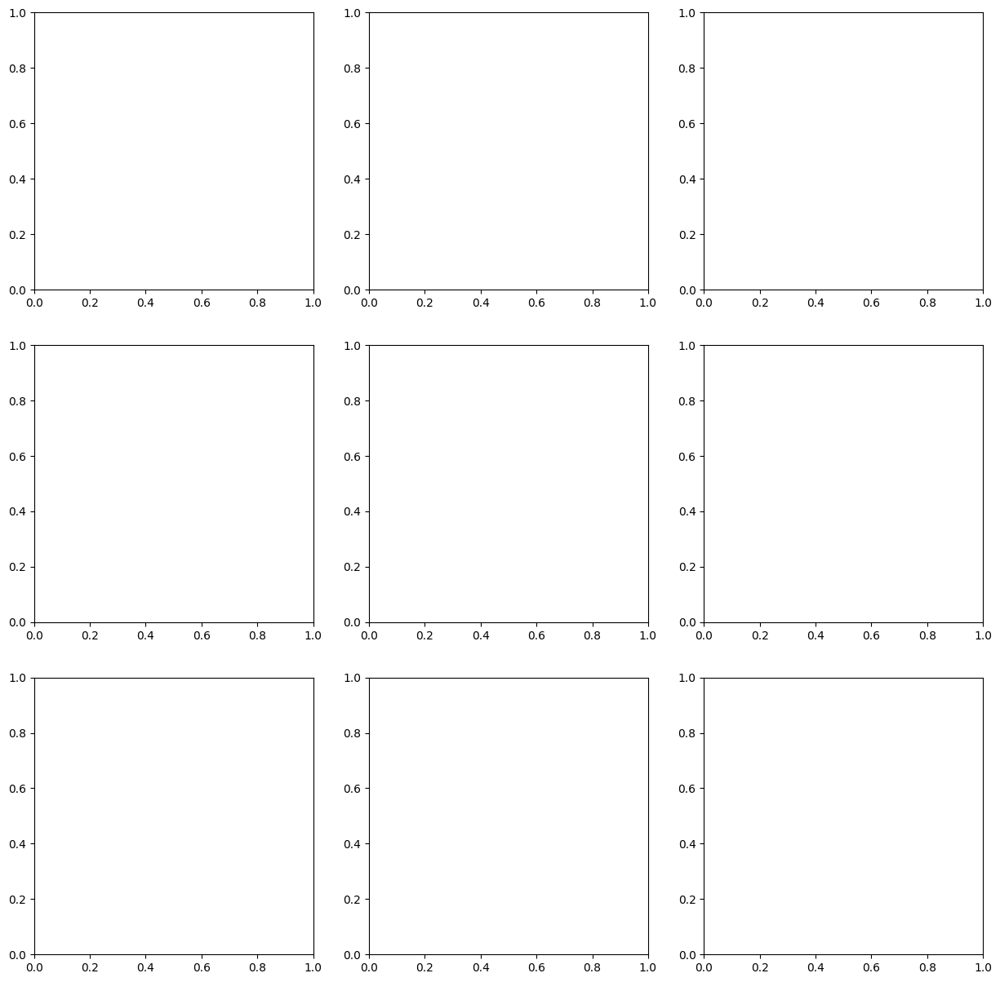

In [164]:
# the plot cell that will generate all plots with all 3 delays and all 3 signals 

delay = [0, 1, 10] # num_delay between adjecent row = 0.1s = 100ms
t_name = ['0s','100ms','1s']
str_name = ['MA','MOM','1s']
b = 0.005
short_window = 12; long_window = 26
fig, ax = plt.subplots(3,3, figsize=(15,15))

for i, j in enumerate(delay):
    ma = moving_average_signal(df, short_window, long_window, b, j)
    ma_df = execute_trading_signal(df, ma, order_size=1_000_000)
    mom = momentum_in_price_signal(df, short_window, long_window, b, j)
    mom_df = execute_trading_signal(df, mom, order_size=1_000_000)
    obv = spread_order_imbalance(df, short_window,long_window, j)
    obv_df = execute_trading_signal(df, obv, order_size=1_000_000)
    
    ax[i][0].plot(ma_df.set_index('Time').resample('D').last().cum_return)
    ax[i][0].set_title(f'MA strategy, delay for {t_name[i]}')
    ax[i][1].plot(mom_df.set_index('Time').resample('D').last().cum_return)
    ax[i][1].set_title(f'MOM strategy, delay for {t_name[i]}')
    ax[i][2].plot(obv_df.set_index('Time').resample('D').last().cum_return)
    ax[i][2].set_title(f'OBV strategy, delay for {t_name[i]}')
    
    plt.show()